# Problem Statement and Goal
The customer data is given as the dataset. There are multiple factors which affect the customer spending, loyalty and purchases for the business. It contains information about customers, their purchases, products, and transaction details. The data includes various attributes such as customer ID, name, email, phone, address, city, state, zipcode, country, age, gender, income, customer segment, last purchase date, total purchases, amount spent, product category, product brand, product type, feedback, shipping method, payment method, and order status. By analyzing these factors, a business can take steps to increase profits, improve customer service and avoid customer churn.

The goal of this notebook is to do an analysis of the given data and then segment the customers using RFM approach.

# Approach
1.Import necessary libraries

2.Get data

3.Explore and analyze data using visualization techniques

4.Prepare data for segmentation

5.Clustering model for customer segmentation

6.Final Segmentation

7.Conclusion

# Import Libraries

In [4]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
pio.templates.default = 'plotly_dark'
import warnings
warnings.filterwarnings('ignore')
plt.rcParams['figure.figsize']=[12,8]

# Data Collection

In [6]:
# load the datasets
df=pd.read_csv('new_retail_data.csv')
df

,Transaction_ID,Customer_ID,Name,Email,Phone,Address,City,State,Zipcode,Country,...,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Shipping_Method,Payment_Method,Order_Status,Ratings,products
0,8691788.0,37249.0,Michelle Harrington,Ebony39@gmail.com,1.414787e+09,3959 Amanda Burgs,Dortmund,Berlin,77985.0,Germany,...,324.086270,Clothing,Nike,Shorts,Excellent,Same-Day,Debit Card,Shipped,5.0,Cycling shorts
1,2174773.0,69749.0,Kelsey Hill,Mark36@gmail.com,6.852900e+09,82072 Dawn Centers,Nottingham,England,99071.0,UK,...,806.707815,Electronics,Samsung,Tablet,Excellent,Standard,Credit Card,Processing,4.0,Lenovo Tab
2,6679610.0,30192.0,Scott Jensen,Shane85@gmail.com,8.362160e+09,4133 Young Canyon,Geelong,New South Wales,75929.0,Australia,...,1063.432799,Books,Penguin Books,Children's,Average,Same-Day,Credit Card,Processing,2.0,Sports equipment
3,7232460.0,62101.0,Joseph Miller,Mary34@gmail.com,2.776752e+09,8148 Thomas Creek Suite 100,Edmonton,Ontario,88420.0,Canada,...,2466.854021,Home Decor,Home Depot,Tools,Excellent,Standard,PayPal,Processing,4.0,Utility knife
4,4983775.0,27901.0,Debra Coleman,Charles30@gmail.com,9.098268e+09,5813 Lori Ports Suite 269,Bristol,England,48704.0,UK,...,248.553049,Grocery,Nestle,Chocolate,Bad,Standard,Cash,Shipped,1.0,Chocolate cookies
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
302005,4246475.0,12104.0,Meagan Ellis,Courtney60@gmail.com,7.466354e+09,389 Todd Path Apt. 159,Townsville,New South Wales,4567.0,Australia,...,973.962984,Books,Penguin Books,Fiction,Bad,Same-Day,Cash,Processing,1.0,Historical fiction
302006,1197603.0,69772.0,Mathew Beck,Jennifer71@gmail.com,5.754305e+09,52809 Mark Forges,Hanover,Berlin,16852.0,Germany,...,285.137301,Electronics,Apple,Laptop,Excellent,Same-Day,Cash,Processing,5.0,LG Gram
302007,7743242.0,28449.0,Daniel Lee,Christopher100@gmail.com,9.382530e+09,407 Aaron Crossing Suite 495,Brighton,England,88038.0,UK,...,182.105285,Clothing,Adidas,Jacket,Average,Express,Cash,Shipped,2.0,Parka
302008,9301950.0,45477.0,Patrick Wilson,Rebecca65@gmail.com,9.373222e+09,3204 Baird Port,Halifax,Ontario,67608.0,Canada,...,120.834784,Home Decor,IKEA,Furniture,Good,Standard,Cash,Shipped,4.0,TV stand


In [7]:
#basic info
df.shape

(302010, 30)

In [8]:
df.size

9060300

In [9]:
pd.set_option('display.max_columns',None)

In [10]:
df.head()

,Transaction_ID,Customer_ID,Name,Email,Phone,Address,City,State,Zipcode,Country,Age,Gender,Income,Customer_Segment,Date,Year,Month,Time,Total_Purchases,Amount,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Shipping_Method,Payment_Method,Order_Status,Ratings,products
0,8691788.0,37249.0,Michelle Harrington,Ebony39@gmail.com,1.414787e+09,3959 Amanda Burgs,Dortmund,Berlin,77985.0,Germany,21.0,Male,Low,Regular,9/18/2023,2023.0,September,22:03:55,3.0,108.028757,324.086270,Clothing,Nike,Shorts,Excellent,Same-Day,Debit Card,Shipped,5.0,Cycling shorts
1,2174773.0,69749.0,Kelsey Hill,Mark36@gmail.com,6.852900e+09,82072 Dawn Centers,Nottingham,England,99071.0,UK,19.0,Female,Low,Premium,12/31/2023,2023.0,December,8:42:04,2.0,403.353907,806.707815,Electronics,Samsung,Tablet,Excellent,Standard,Credit Card,Processing,4.0,Lenovo Tab
2,6679610.0,30192.0,Scott Jensen,Shane85@gmail.com,8.362160e+09,4133 Young Canyon,Geelong,New South Wales,75929.0,Australia,48.0,Male,Low,Regular,4/26/2023,2023.0,April,4:06:29,3.0,354.477600,1063.432799,Books,Penguin Books,Children's,Average,Same-Day,Credit Card,Processing,2.0,Sports equipment
3,7232460.0,62101.0,Joseph Miller,Mary34@gmail.com,2.776752e+09,8148 Thomas Creek Suite 100,Edmonton,Ontario,88420.0,Canada,56.0,Male,High,Premium,5/8/2023,2023.0,May,14:55:17,7.0,352.407717,2466.854021,Home Decor,Home Depot,Tools,Excellent,Standard,PayPal,Processing,4.0,Utility knife
4,4983775.0,27901.0,Debra Coleman,Charles30@gmail.com,9.098268e+09,5813 Lori Ports Suite 269,Bristol,England,48704.0,UK,22.0,Male,Low,Premium,1/10/2024,2024.0,January,16:54:07,2.0,124.276524,248.553049,Grocery,Nestle,Chocolate,Bad,Standard,Cash,Shipped,1.0,Chocolate cookies


In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 302010 entries, 0 to 302009
Data columns (total 30 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Transaction_ID    301677 non-null  float64
 1   Customer_ID       301702 non-null  float64
 2   Name              301628 non-null  object 
 3   Email             301663 non-null  object 
 4   Phone             301648 non-null  float64
 5   Address           301695 non-null  object 
 6   City              301762 non-null  object 
 7   State             301729 non-null  object 
 8   Zipcode           301670 non-null  float64
 9   Country           301739 non-null  object 
 10  Age               301837 non-null  float64
 11  Gender            301693 non-null  object 
 12  Income            301720 non-null  object 
 13  Customer_Segment  301795 non-null  object 
 14  Date              301651 non-null  object 
 15  Year              301660 non-null  float64
 16  Month             30

# Datasets Description

##Dataset Description:

The dataset represents retail transactional data. It contains information about customers, their purchases, products, and transaction details. The data includes various attributes such as customer ID, name, email, phone, address, city, state, zipcode, country, age, gender, income, customer segment, last purchase date, total purchases, amount spent, product category, product brand, product type, feedback, shipping method, payment method, and order status.
##Key Points: ##Customer Information:

Includes customer details like ID, name, email, phone, address, city, state, zipcode, country, age, and gender. Customer segments are categorized into Premium, Regular, and New.
##Transaction Details:

Transaction-specific data such as transaction ID, last purchase date, total purchases, amount spent, total purchase amount, feedback, shipping method, payment method, and order status.
##Product Information:

Contains product-related details such as product category, brand, and type. Products are categorized into electronics, clothing, grocery, books, and home decor.
##Geographic Information:

Contains location details including city, state, and country. Available for various countries including USA, UK, Canada, Australia, and Germany.
##Temporal Information:

Last purchase date is provided along with separate columns for year, month, date, and time. Allows analysis based on temporal patterns and trends.
##Data Quality:

Some rows contain null values, and others are duplicates, which may need to be handled during data preprocessing. Null values are randomly distributed across rows. Duplicate rows are available at different parts of the dataset.
##Potential Analysis:

Customer segmentation analysis based on demographics, purchase behavior, and feedback. Sales trend analysis over time to identify peak seasons or trends. Product performance analysis to determine popular categories, brands, or types. Geographic analysis to understand regional preferences and trends. Payment and shipping method analysis to optimize services. Customer satisfaction analysis based on feedback and order status.
##Data Preprocessing:

Handling null values and duplicates. Parsing and formatting temporal data. Encoding categorical variables. Scaling numerical variables if required. Splitting data into training and testing sets for modeling.

# columns Descriptions

# Transaction_ID:
Type: int64
Explanation: Unique identifier for each transaction.
# Customer_ID:
Type: int64
Explanation: Unique identifier for each customer.
# Name:
Type: object
Explanation: Name of the customer.
# Email:
Type: object
Explanation: Email address of the customer.
# Phone:
Type: object
Explanation: Phone number of the customer.
# Address:
Type: object
Explanation: Address of the customer.
# City:
Type: object
Explanation: City where the customer resides.
# State:
Type: object
Explanation: State where the customer resides.
# Zipcode:
Type: object
Explanation: Zip code of the customer's address.
# Country:
Type: object
Explanation: Country where the customer resides.
# Age:
Type: int64
Explanation: Age of the customer.
# Gender:
Type: object
Explanation: Gender of the customer.
# Income:
Type: object
Explanation: Income level of the customer.
# Customer_Segment:
Type: object
Explanation: Segment of the customer (e.g., Premium, Regular, New).
# Year:
Type: int64
Explanation: Year component extracted from the last purchase date.
# Month:
Type: object
Explanation: Month component extracted from the last purchase date.
# Date:
Type: object
Explanation: Date component extracted from the last purchase date.
# Time:
Type: object
Explanation: Time component extracted from the last purchase date.
# Total_Purchases:
Type: int64
Explanation: Total number of purchases made by the customer.
# Amount:
Type: float64
Explanation: Amount spent in a single transaction.
# Total_Purchase_Amount:
Type: float64
Explanation: Total amount spent by the customer (calculated as Amount * Total_Purchases).
# Product_Category:
Type: object
Explanation: Category of the purchased product.
# Product_Brand:
Type: object
Explanation: Brand of the purchased product.
# Product_Type:
Type: object
Explanation: Type of the purchased product.
# Feedback:
Type: object
Explanation: Feedback provided by the customer on the purchase.
# Shipping_Method:
Type: object
Explanation: Method used for shipping the product.
# Payment_Method:
Type: object
Explanation: Method used for payment.
# Order_Status:
Type: object
Explanation: Status of the order (e.g., Pending, Processing, Shipped, Delivered).

In [16]:
df.describe()

,Transaction_ID,Customer_ID,Phone,Zipcode,Age,Year,Total_Purchases,Amount,Total_Amount,Ratings
count,3.016770e+05,301702.000000,3.016480e+05,301670.000000,301837.000000,301660.000000,301649.000000,301653.000000,301660.000000,301826.000000
mean,5.495823e+06,55006.553934,5.501464e+09,50298.951019,35.481326,2023.165113,5.359729,255.163659,1367.651156,3.162670
std,2.595565e+06,26005.675200,2.596017e+09,28972.807134,15.021933,0.371283,2.868575,141.389640,1128.998515,1.320827
min,1.000007e+06,10000.000000,1.000049e+09,501.000000,18.000000,2023.000000,1.000000,10.000219,10.003750,1.000000
25%,3.247930e+06,32469.250000,3.255061e+09,25425.000000,22.000000,2023.000000,3.000000,132.890764,438.724278,2.000000
50%,5.499657e+06,55012.000000,5.505812e+09,50602.500000,32.000000,2023.000000,5.000000,255.470969,1041.117547,3.000000
75%,7.739509e+06,77511.000000,7.749860e+09,75252.000000,46.000000,2023.000000,8.000000,377.672606,2029.999853,4.000000
max,9.999995e+06,99999.000000,9.999996e+09,99949.000000,70.000000,2024.000000,10.000000,499.997911,4999.625796,5.000000


In [17]:
df1=df.copy()

In [18]:
df1

,Transaction_ID,Customer_ID,Name,Email,Phone,Address,City,State,Zipcode,Country,Age,Gender,Income,Customer_Segment,Date,Year,Month,Time,Total_Purchases,Amount,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Shipping_Method,Payment_Method,Order_Status,Ratings,products
0,8691788.0,37249.0,Michelle Harrington,Ebony39@gmail.com,1.414787e+09,3959 Amanda Burgs,Dortmund,Berlin,77985.0,Germany,21.0,Male,Low,Regular,9/18/2023,2023.0,September,22:03:55,3.0,108.028757,324.086270,Clothing,Nike,Shorts,Excellent,Same-Day,Debit Card,Shipped,5.0,Cycling shorts
1,2174773.0,69749.0,Kelsey Hill,Mark36@gmail.com,6.852900e+09,82072 Dawn Centers,Nottingham,England,99071.0,UK,19.0,Female,Low,Premium,12/31/2023,2023.0,December,8:42:04,2.0,403.353907,806.707815,Electronics,Samsung,Tablet,Excellent,Standard,Credit Card,Processing,4.0,Lenovo Tab
2,6679610.0,30192.0,Scott Jensen,Shane85@gmail.com,8.362160e+09,4133 Young Canyon,Geelong,New South Wales,75929.0,Australia,48.0,Male,Low,Regular,4/26/2023,2023.0,April,4:06:29,3.0,354.477600,1063.432799,Books,Penguin Books,Children's,Average,Same-Day,Credit Card,Processing,2.0,Sports equipment
3,7232460.0,62101.0,Joseph Miller,Mary34@gmail.com,2.776752e+09,8148 Thomas Creek Suite 100,Edmonton,Ontario,88420.0,Canada,56.0,Male,High,Premium,5/8/2023,2023.0,May,14:55:17,7.0,352.407717,2466.854021,Home Decor,Home Depot,Tools,Excellent,Standard,PayPal,Processing,4.0,Utility knife
4,4983775.0,27901.0,Debra Coleman,Charles30@gmail.com,9.098268e+09,5813 Lori Ports Suite 269,Bristol,England,48704.0,UK,22.0,Male,Low,Premium,1/10/2024,2024.0,January,16:54:07,2.0,124.276524,248.553049,Grocery,Nestle,Chocolate,Bad,Standard,Cash,Shipped,1.0,Chocolate cookies
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
302005,4246475.0,12104.0,Meagan Ellis,Courtney60@gmail.com,7.466354e+09,389 Todd Path Apt. 159,Townsville,New South Wales,4567.0,Australia,31.0,Male,Medium,Regular,1/20/2024,2024.0,January,23:40:29,5.0,194.792597,973.962984,Books,Penguin Books,Fiction,Bad,Same-Day,Cash,Processing,1.0,Historical fiction
302006,1197603.0,69772.0,Mathew Beck,Jennifer71@gmail.com,5.754305e+09,52809 Mark Forges,Hanover,Berlin,16852.0,Germany,35.0,Female,Low,New,12/28/2023,2023.0,December,2:55:45,1.0,285.137301,285.137301,Electronics,Apple,Laptop,Excellent,Same-Day,Cash,Processing,5.0,LG Gram
302007,7743242.0,28449.0,Daniel Lee,Christopher100@gmail.com,9.382530e+09,407 Aaron Crossing Suite 495,Brighton,England,88038.0,UK,41.0,Male,Low,Premium,2/27/2024,2024.0,February,2:43:49,3.0,60.701761,182.105285,Clothing,Adidas,Jacket,Average,Express,Cash,Shipped,2.0,Parka
302008,9301950.0,45477.0,Patrick Wilson,Rebecca65@gmail.com,9.373222e+09,3204 Baird Port,Halifax,Ontario,67608.0,Canada,41.0,Male,Medium,New,9/3/2023,2023.0,September,11:20:31,1.0,120.834784,120.834784,Home Decor,IKEA,Furniture,Good,Standard,Cash,Shipped,4.0,TV stand


In [19]:
#no of missing values in each column
(df1.isnull().sum())/len(df)*100

Transaction_ID      0.110261
Customer_ID         0.101983
Name                0.126486
Email               0.114897
Phone               0.119864
Address             0.104301
City                0.082116
State               0.093043
Zipcode             0.112579
Country             0.089732
Age                 0.057283
Gender              0.104963
Income              0.096023
Customer_Segment    0.071190
Date                0.118870
Year                0.115890
Month               0.090394
Time                0.115890
Total_Purchases     0.119532
Amount              0.118208
Total_Amount        0.115890
Product_Category    0.093706
Product_Brand       0.093043
Product_Type        0.000000
Feedback            0.060925
Shipping_Method     0.111586
Payment_Method      0.098341
Order_Status        0.077812
Ratings             0.060925
products            0.000000
dtype: float64

In [20]:
df1.isnull().sum()

Transaction_ID      333
Customer_ID         308
Name                382
Email               347
Phone               362
Address             315
City                248
State               281
Zipcode             340
Country             271
Age                 173
Gender              317
Income              290
Customer_Segment    215
Date                359
Year                350
Month               273
Time                350
Total_Purchases     361
Amount              357
Total_Amount        350
Product_Category    283
Product_Brand       281
Product_Type          0
Feedback            184
Shipping_Method     337
Payment_Method      297
Order_Status        235
Ratings             184
products              0
dtype: int64

In [21]:
# Calculate the percentage of rows with missing data
missing_percentage = (df1.isnull().any(axis=1).mean() * 100)
print(f'Percentage of rows with missing data: {missing_percentage:.2f}%')


Percentage of rows with missing data: 2.68%


In [22]:
# onlt 2.68% percentage of missing values in the data so we prefer to drop the missing rows

In [23]:
df1.dropna(inplace=True)

In [24]:
df1.isnull().sum()

Transaction_ID      0
Customer_ID         0
Name                0
Email               0
Phone               0
Address             0
City                0
State               0
Zipcode             0
Country             0
Age                 0
Gender              0
Income              0
Customer_Segment    0
Date                0
Year                0
Month               0
Time                0
Total_Purchases     0
Amount              0
Total_Amount        0
Product_Category    0
Product_Brand       0
Product_Type        0
Feedback            0
Shipping_Method     0
Payment_Method      0
Order_Status        0
Ratings             0
products            0
dtype: int64

In [25]:
#check for duplicates
df1.duplicated().sum()

3

In [26]:
df1[df1.duplicated]

,Transaction_ID,Customer_ID,Name,Email,Phone,Address,City,State,Zipcode,Country,Age,Gender,Income,Customer_Segment,Date,Year,Month,Time,Total_Purchases,Amount,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Shipping_Method,Payment_Method,Order_Status,Ratings,products
299759,4476510.0,20103.0,Christine Kim,James11@gmail.com,2.383778e+09,8176 Randy Squares Apt. 772,Kitchener,Ontario,7099.0,Canada,54.0,Female,Low,Regular,12/10/2023,2023.0,December,1:09:09,7.0,134.374182,940.619277,Clothing,Adidas,T-shirt,Bad,Express,Credit Card,Processing,1.0,Off-the-shoulder tee
301362,4942326.0,25416.0,Pamela Martin,Christine83@gmail.com,6.657934e+09,9851 Myers Tunnel,Leicester,England,57655.0,UK,63.0,Male,Low,Regular,5/5/2023,2023.0,May,4:17:21,8.0,191.906886,1535.255087,Clothing,Adidas,Jacket,Average,Same-Day,Cash,Pending,2.0,Varsity jacket
301486,3200766.0,49598.0,Mikayla Mueller,Kenneth43@gmail.com,6.980439e+09,716 Joshua Rapids Apt. 790,Bremen,Berlin,64747.0,Germany,59.0,Male,Low,New,11/23/2023,2023.0,November,15:35:49,9.0,272.327418,2450.946762,Grocery,Pepsi,Soft Drink,Bad,Standard,Cash,Pending,1.0,Iced tea


# Explotary Data Analysis

In [28]:
#remove the duplicates
df1=df1.drop_duplicates()

In [29]:
df1.duplicated().sum()

0

In [30]:
df1.shape

(293908, 30)

In [31]:
# check for the anamolies
df1['City'].unique()

array(['Dortmund', 'Nottingham', 'Geelong', 'Edmonton', 'Bristol',
       'Brisbane', 'Kitchener', 'Munich', 'Wollongong', 'Cologne',
       'Portsmouth', 'San Jose', 'Hamilton', 'Manchester', 'Cardiff',
       'Glasgow', 'Hull', 'Southampton', 'Leipzig', 'Cairns', 'London',
       'Bielefeld', 'Düsseldorf', 'Philadelphia', 'Halifax', 'Montreal',
       'Mackay', 'Quebec City', 'Adelaide', 'Leeds', 'Plymouth', 'Perth',
       'Sheffield', 'Frankfurt', 'Toronto', 'Essen', 'Kelowna',
       'Birmingham', 'Ottawa', 'Liverpool', "St. John's", 'Hobart',
       'Atlanta', 'New Orleans', 'Wichita', 'Cleveland', 'Albury-Wodonga',
       'Winnipeg', 'Hamburg', 'Windsor', 'Calgary', 'Newcastle upon Tyne',
       'Townsville', 'Oshawa', 'Houston', 'Seattle', 'Charlotte',
       'New York', 'Milwaukee', 'Edinburgh', 'Launceston', 'Bochum',
       'Münster', 'Bonn', 'Columbus', 'Melbourne', 'Leicester',
       'Fort Worth', 'Toowoomba', 'Victoria', 'Oxford', 'Canberra',
       'Vancouver', 'Saskato

In [32]:
df1['City'].nunique()

130

In [33]:
df1['State'].unique()

array(['Berlin', 'England', 'New South Wales', 'Ontario', 'Virginia',
       'Colorado', 'Arkansas', 'Texas', 'Oklahoma', 'Connecticut',
       'Mississippi', 'Wisconsin', 'Nevada', 'Oregon', 'Michigan',
       'Alaska', 'New Jersey', 'Wyoming', 'Maine', 'Idaho', 'Alabama',
       'New Hampshire', 'Minnesota', 'Delaware', 'South Carolina',
       'Nebraska', 'New Mexico', 'Arizona', 'Indiana', 'Iowa', 'Illinois',
       'Ohio', 'Georgia', 'New York', 'Pennsylvania', 'Massachusetts',
       'Rhode Island', 'Montana', 'Missouri', 'West Virginia',
       'Louisiana', 'Kansas', 'Kentucky', 'Washington', 'South Dakota',
       'California', 'Utah', 'Hawaii', 'North Carolina', 'Maryland',
       'Vermont', 'North Dakota', 'Tennessee', 'Florida'], dtype=object)

In [34]:
df1.columns

Index(['Transaction_ID', 'Customer_ID', 'Name', 'Email', 'Phone', 'Address',
       'City', 'State', 'Zipcode', 'Country', 'Age', 'Gender', 'Income',
       'Customer_Segment', 'Date', 'Year', 'Month', 'Time', 'Total_Purchases',
       'Amount', 'Total_Amount', 'Product_Category', 'Product_Brand',
       'Product_Type', 'Feedback', 'Shipping_Method', 'Payment_Method',
       'Order_Status', 'Ratings', 'products'],
      dtype='object')

In [35]:
def get_unique_values(df):
    for col in df1.columns:
        print(f'{col}:{df1[col].nunique()}')

get_unique_values(df1)

Transaction_ID:287005
Customer_ID:86485
Name:156638
Email:52530
Phone:291620
Address:291610
City:130
State:54
Zipcode:93580
Country:5
Age:53
Gender:2
Income:3
Customer_Segment:3
Date:366
Year:2
Month:12
Time:83435
Total_Purchases:10
Amount:291615
Total_Amount:291618
Product_Category:5
Product_Brand:18
Product_Type:33
Feedback:4
Shipping_Method:3
Payment_Method:4
Order_Status:4
Ratings:5
products:318


In [36]:
df1.dtypes

Transaction_ID      float64
Customer_ID         float64
Name                 object
Email                object
Phone               float64
Address              object
City                 object
State                object
Zipcode             float64
Country              object
Age                 float64
Gender               object
Income               object
Customer_Segment     object
Date                 object
Year                float64
Month                object
Time                 object
Total_Purchases     float64
Amount              float64
Total_Amount        float64
Product_Category     object
Product_Brand        object
Product_Type         object
Feedback             object
Shipping_Method      object
Payment_Method       object
Order_Status         object
Ratings             float64
products             object
dtype: object

In [37]:
# convert datecolumns to datetime 
df1['Date']=pd.to_datetime(df1['Date'])
df1['Month']=df1['Date'].dt.month_name()
df1['Year']=df1['Date'].dt.year

In [38]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 293908 entries, 0 to 302009
Data columns (total 30 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Transaction_ID    293908 non-null  float64       
 1   Customer_ID       293908 non-null  float64       
 2   Name              293908 non-null  object        
 3   Email             293908 non-null  object        
 4   Phone             293908 non-null  float64       
 5   Address           293908 non-null  object        
 6   City              293908 non-null  object        
 7   State             293908 non-null  object        
 8   Zipcode           293908 non-null  float64       
 9   Country           293908 non-null  object        
 10  Age               293908 non-null  float64       
 11  Gender            293908 non-null  object        
 12  Income            293908 non-null  object        
 13  Customer_Segment  293908 non-null  object        
 14  Date     

In [39]:
# total amount column is the multiply of total_purchases and amount
df1['Total_Amount']=df1['Total_Purchases']*df1['Amount']
df1['Total_Amount']

0          324.086270
1          806.707815
2         1063.432799
3         2466.854021
4          248.553049
             ...     
302005     973.962985
302006     285.137301
302007     182.105284
302008     120.834784
302009    2382.233416
Name: Total_Amount, Length: 293908, dtype: float64

In [40]:
df1['Total_Purchases'] = df1['Total_Purchases'].astype(int)
df1['Age'] = df1['Age'].astype(int)
df1['Ratings']=df1['Ratings'].astype(str)

In [41]:
df1.describe().T

,count,mean,min,25%,50%,75%,max,std
Transaction_ID,293908.0,5493738.724778,1000007.0,3245885.75,5495915.0,7738209.75,9999995.0,2596094.868905
Customer_ID,293908.0,55013.638431,10000.0,32470.0,55027.0,77514.0,99999.0,26009.429623
Phone,293908.0,5500608709.169086,1000049414.0,3253506772.5,5504455104.0,7749807399.5,9999996122.0,2596115745.702728
Zipcode,293908.0,50288.45652,501.0,25408.0,50586.0,75252.25,99949.0,28976.636935
Age,293908.0,35.46553,18.0,22.0,32.0,46.0,70.0,15.017638
Date,293908,2023-08-30 16:41:17.673285632,2023-03-01 00:00:00,2023-05-31 00:00:00,2023-08-31 00:00:00,2023-11-30 00:00:00,2024-02-29 00:00:00,NaN
Year,293908.0,2023.165127,2023.0,2023.0,2023.0,2023.0,2024.0,0.371295
Total_Purchases,293908.0,5.359837,1.0,3.0,5.0,8.0,10.0,2.868441
Amount,293908.0,255.153875,10.000219,132.837594,255.464523,377.639394,499.997911,141.389109
Total_Amount,293908.0,1367.68418,10.00375,438.844052,1041.16429,2028.951754,4999.625796,1128.89884


In [42]:
#Creating a fresh dataset for data visualization
df2 = df1[['Country', 'Age', 'Gender', 'Income','State',
       'Customer_Segment', 'Date', 'Year', 'Month', 'Total_Purchases',
       'Amount', 'Total_Amount', 'Product_Category', 'Product_Brand',
       'Product_Type', 'Feedback', 'Shipping_Method', 'Payment_Method',
       'Order_Status', 'Ratings', 'products']]

In [43]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 293908 entries, 0 to 302009
Data columns (total 21 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Country           293908 non-null  object        
 1   Age               293908 non-null  int64         
 2   Gender            293908 non-null  object        
 3   Income            293908 non-null  object        
 4   State             293908 non-null  object        
 5   Customer_Segment  293908 non-null  object        
 6   Date              293908 non-null  datetime64[ns]
 7   Year              293908 non-null  int32         
 8   Month             293908 non-null  object        
 9   Total_Purchases   293908 non-null  int64         
 10  Amount            293908 non-null  float64       
 11  Total_Amount      293908 non-null  float64       
 12  Product_Category  293908 non-null  object        
 13  Product_Brand     293908 non-null  object        
 14  Product_T

In [44]:
# split the datas
num=df2.select_dtypes(include=np.number).columns.to_list()
num

['Age', 'Year', 'Total_Purchases', 'Amount', 'Total_Amount']

In [45]:
cat=df2.select_dtypes(exclude=np.number).columns.to_list()
cat

['Country',
 'Gender',
 'Income',
 'State',
 'Customer_Segment',
 'Date',
 'Month',
 'Product_Category',
 'Product_Brand',
 'Product_Type',
 'Feedback',
 'Shipping_Method',
 'Payment_Method',
 'Order_Status',
 'Ratings',
 'products']

In [46]:
df2[num].corr()

,Age,Year,Total_Purchases,Amount,Total_Amount
Age,1.000000,-0.002187,0.032965,0.001046,0.022487
Year,-0.002187,1.000000,-0.002024,0.001469,-0.001901
Total_Purchases,0.032965,-0.002024,1.000000,0.000249,0.649183
Amount,0.001046,0.001469,0.000249,1.000000,0.670601
Total_Amount,0.022487,-0.001901,0.649183,0.670601,1.000000


### Age and Ratings: 
A moderate positive correlation (0.167) suggests older customers tend to give slightly higher ratings. This indicates older demographics may be more satisfied with their purchases or have differing expectations compared to younger groups.

### Total Purchases and Total Amount:
A strong positive correlation (0.649) shows that higher purchase frequency leads to significantly increased spending. This highlights the importance of engaging frequent buyers to drive overall revenue.

### Other Variables:
Weak or negligible correlations exist between variables such as Total Purchases and Ratings (-0.004), Total Amount and Ratings (-0.003), and Year with other variables. These suggest limited or no direct relationships in these areas.

## Recommended Business Insights:

### Targeted Engagement by Age Group:
Tailor marketing efforts to older customers with personalized offers, leveraging their tendency to give higher ratings. For younger customers, focus on improving their satisfaction levels through feedback-driven enhancements.

### Loyalty Programs for Frequent Buyers:
Strengthen loyalty programs targeting customers with high purchase frequency, as they are likely to contribute significantly to total revenue.

### Improve Rating Predictability: 
Weak correlations between Ratings and other variables suggest satisfaction depends on unexamined factors (e.g., product quality, service). Conduct deeper analysis to identify drivers of customer satisfaction.

### Strategic Upselling:
Use purchase-frequency patterns to recommend premium products or bundles to frequent buyers, maximizing revenue potential.

These insights can inform strategies to enhance customer satisfaction, loyalty, and revenue generation.

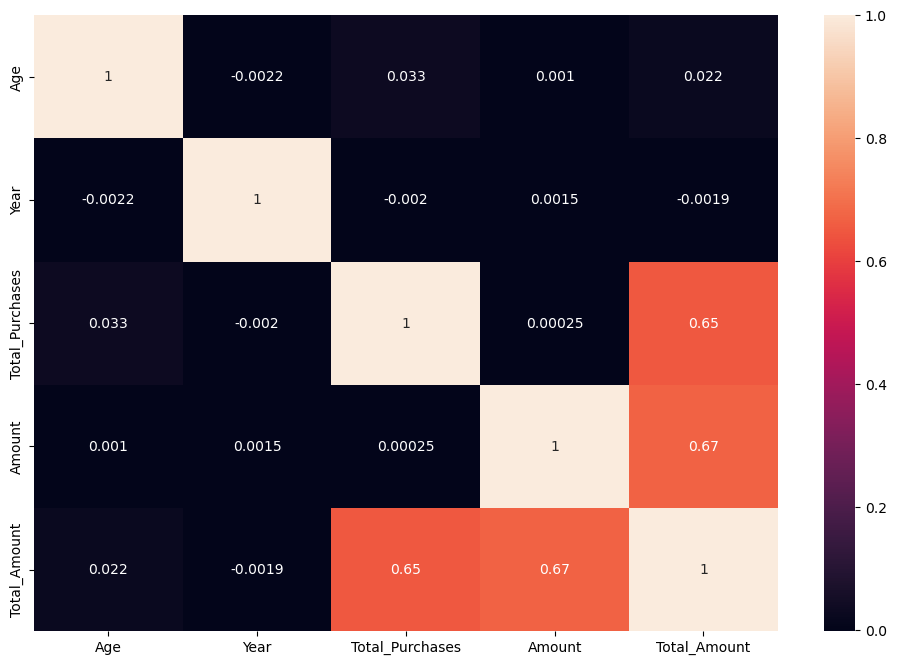

In [48]:
sns.heatmap(df2[num].corr(),annot=True)
plt.show()

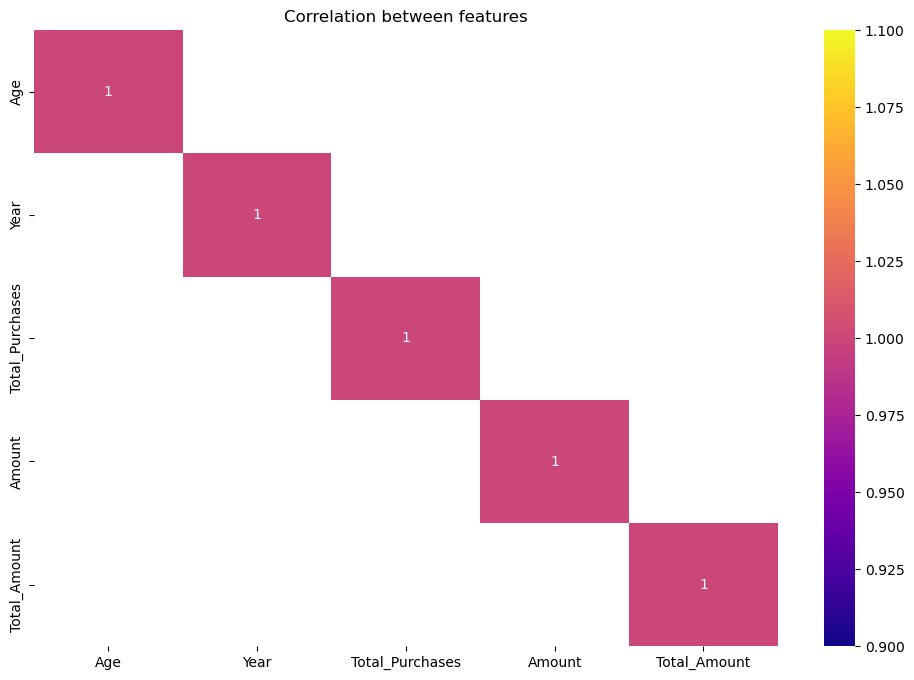

In [49]:
sns.heatmap(df2[num].corr()[(df2[num].corr()>=0.75)|(df2[num].corr()<=-0.75)],cmap='plasma',annot=True)
plt.title('Correlation between features')
plt.show()

In [50]:
df2[num].skew()

Age                0.654366
Year               1.803824
Total_Purchases    0.072437
Amount            -0.002033
Total_Amount       0.972928
dtype: float64

In [51]:
#checking for outliers

In [52]:
q1=df1[num].quantile(0.25)
q3=df1[num].quantile(0.75)
iqr=q3-q1
lower_limit=q1-1.5*iqr
upper_limit=q3+1.5*iqr

In [53]:
outliers=df2[((df2[num]<lower_limit)|(df2[num]>upper_limit)).any(axis=1)]
outliers

,Country,Age,Gender,Income,State,Customer_Segment,Date,Year,Month,Total_Purchases,Amount,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Shipping_Method,Payment_Method,Order_Status,Ratings,products
4,UK,22,Male,Low,England,Premium,2024-01-10,2024,January,2,124.276524,248.553049,Grocery,Nestle,Chocolate,Bad,Standard,Cash,Shipped,1.0,Chocolate cookies
8,Australia,46,Male,Medium,New South Wales,New,2024-01-06,2024,January,8,328.839302,2630.714414,Grocery,Nestle,Chocolate,Bad,Same-Day,Cash,Delivered,1.0,Dark chocolate
12,UK,56,Female,Medium,England,Regular,2024-01-02,2024,January,10,161.879361,1618.793610,Grocery,Coca-Cola,Water,Bad,Standard,PayPal,Delivered,1.0,Bottled water
18,UK,49,Male,Low,England,Regular,2024-02-07,2024,February,1,210.137919,210.137919,Grocery,Coca-Cola,Juice,Bad,Express,Credit Card,Shipped,1.0,Orange juice
22,UK,21,Female,Low,England,Regular,2024-02-03,2024,February,6,34.124266,204.745598,Books,Penguin Books,Non-Fiction,Average,Same-Day,PayPal,Processing,2.0,Self-help
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
301987,USA,39,Female,Low,Minnesota,New,2024-01-26,2024,January,5,302.853808,1514.269040,Grocery,Pepsi,Soft Drink,Good,Same-Day,Cash,Delivered,4.0,Lemon-lime soda
302001,Australia,61,Male,Medium,New South Wales,Premium,2024-02-14,2024,February,7,343.066709,2401.466964,Home Decor,Bed Bath & Beyond,Bathroom,Bad,Same-Day,Cash,Processing,1.0,Soap dispenser
302005,Australia,31,Male,Medium,New South Wales,Regular,2024-01-20,2024,January,5,194.792597,973.962985,Books,Penguin Books,Fiction,Bad,Same-Day,Cash,Processing,1.0,Historical fiction
302007,UK,41,Male,Low,England,Premium,2024-02-27,2024,February,3,60.701761,182.105284,Clothing,Adidas,Jacket,Average,Express,Cash,Shipped,2.0,Parka


In [54]:
# univariate analysis for num
df2[num].describe()

,Age,Year,Total_Purchases,Amount,Total_Amount
count,293908.000000,293908.000000,293908.000000,293908.000000,293908.000000
mean,35.465530,2023.165127,5.359837,255.153875,1367.684180
std,15.017638,0.371295,2.868441,141.389109,1128.898840
min,18.000000,2023.000000,1.000000,10.000219,10.003750
25%,22.000000,2023.000000,3.000000,132.837594,438.844052
50%,32.000000,2023.000000,5.000000,255.464523,1041.164290
75%,46.000000,2023.000000,8.000000,377.639394,2028.951754
max,70.000000,2024.000000,10.000000,499.997911,4999.625796


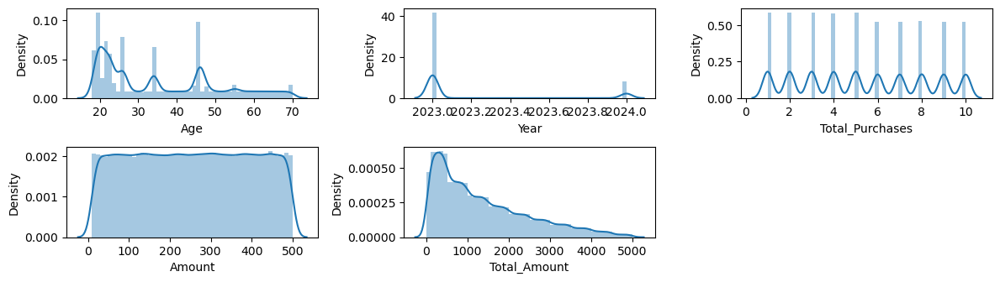

In [55]:
t=1
for i in num:
    plt.subplot(5,3,t)
    sns.distplot(df2[i])
    t+=1
plt.tight_layout()
plt.show()

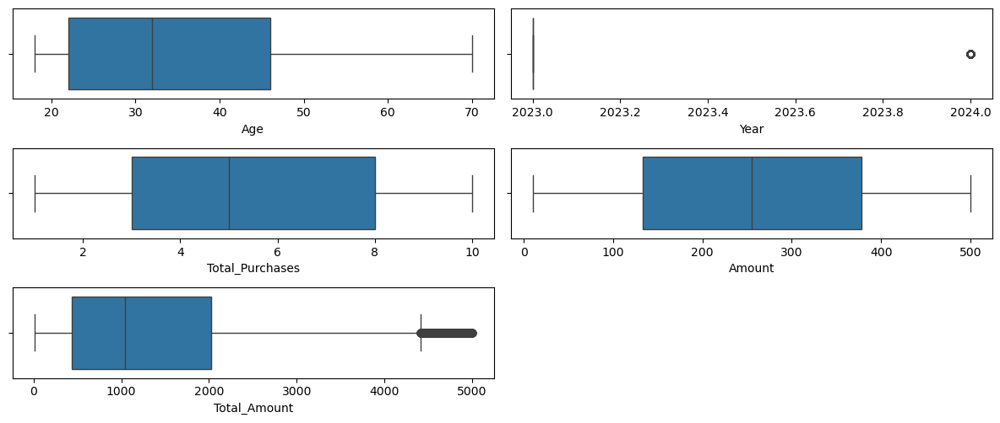

In [56]:
t=1
for i in num:
    plt.subplot(5,2,t)
    sns.boxplot(x=df2[i])
    t+=1
plt.tight_layout()
plt.show()

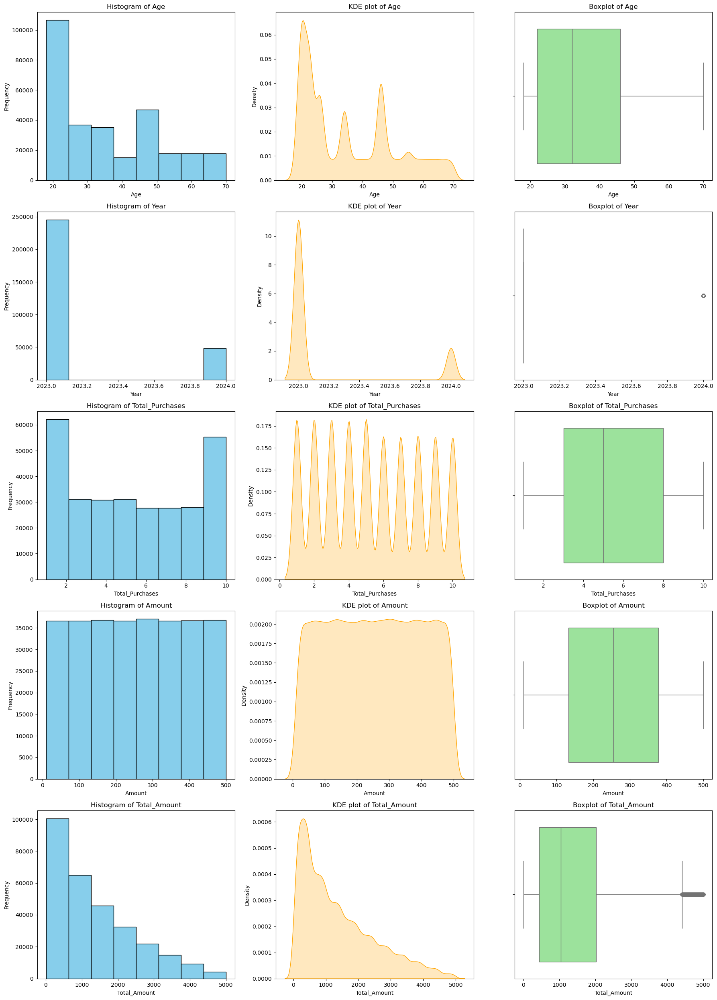

In [57]:
# Create subplots 
fig, axes = plt.subplots(nrows=len(num), ncols=3, figsize=(18, 5 * len(num)))

for i, col in enumerate(num):
    # Histogram
    axes[i, 0].hist(df2[col], bins=8, color='skyblue', edgecolor='black')
    axes[i, 0].set(title=f'Histogram of {col}', xlabel=col, ylabel='Frequency')

    # KDE plot
    sns.kdeplot(df2[col], ax=axes[i, 1], fill=True, color='orange')
    axes[i, 1].set(title=f'KDE plot of {col}', xlabel=col)

    # Boxplot
    sns.boxplot(x=df2[col], ax=axes[i, 2], color='lightgreen')
    axes[i, 2].set(title=f'Boxplot of {col}', xlabel=col)

plt.tight_layout()
plt.show()


## Inference for Numerical Variables

### Age:

Inference: The age distribution is right-skewed, with most customers aged between 20 and 40 years. Outliers exist in older age groups.

Business Insights: Focus marketing efforts on the 20–40 age group, as they form the largest customer base. For older age groups, consider specialized campaigns or offers to retain them.

### Year:

Inference: Almost all transactions occurred in 2023, with minimal data for 2024.

Business Insights: Optimize seasonal campaigns based on 2023 trends. Utilize early 2024 data to predict customer behavior and adjust marketing strategies.

### Total Purchases:

Inference: The distribution is slightly skewed, with most customers making 3–8 purchases. A few outliers made 9–10 purchases.

Business Insights: Target frequent purchasers (top quartile) with loyalty programs and personalized incentives to increase their lifetime value.

### Total Amount:

Inference: The distribution is heavily right-skewed, with most customers spending below ₹2,000. A few high spenders skew the upper end.

Business Insights: Segment and engage high spenders with premium products and exclusive deals. Create budget-friendly offers for lower spenders to increase their average spending.

### Ratings:

Inference: Ratings are concentrated around 3–4, with a few outliers at the extremes.

Business Insights: Improve customer satisfaction by addressing pain points reflected in lower ratings. For customers providing high ratings, encourage repeat purchases through incentives or testimonials.
These insights can guide customer segmentation, satisfaction improvement, and revenue optimization strategies.

In [59]:
print('skewness is ',df2['Total_Amount'].skew())

skewness is  0.9729279695208662


In [60]:
#univariate analysis for cat
for i in cat:
    if i in df2.columns:
        print(df2[i].value_counts(normalize=True))
        print('\n############\n')
    else:
        print(f"Column '{i}' not found in DataFrame.")

Country
USA          0.315745
UK           0.208899
Germany      0.174994
Australia    0.150285
Canada       0.150078
Name: proportion, dtype: float64

############

Gender
Male      0.621834
Female    0.378166
Name: proportion, dtype: float64

############

Income
Medium    0.431751
Low       0.318705
High      0.249544
Name: proportion, dtype: float64

############

State
England            0.208899
Berlin             0.174994
New South Wales    0.150285
Ontario            0.150078
Connecticut        0.071859
Maine              0.040669
Georgia            0.031568
Kansas             0.018288
New Mexico         0.017274
New York           0.003300
Maryland           0.003249
Pennsylvania       0.003188
California         0.003151
Nevada             0.003134
Ohio               0.003134
Illinois           0.003134
Iowa               0.003130
Minnesota          0.003127
Texas              0.003127
South Carolina     0.003103
Mississippi        0.003103
Hawaii             0.003086
Utah   

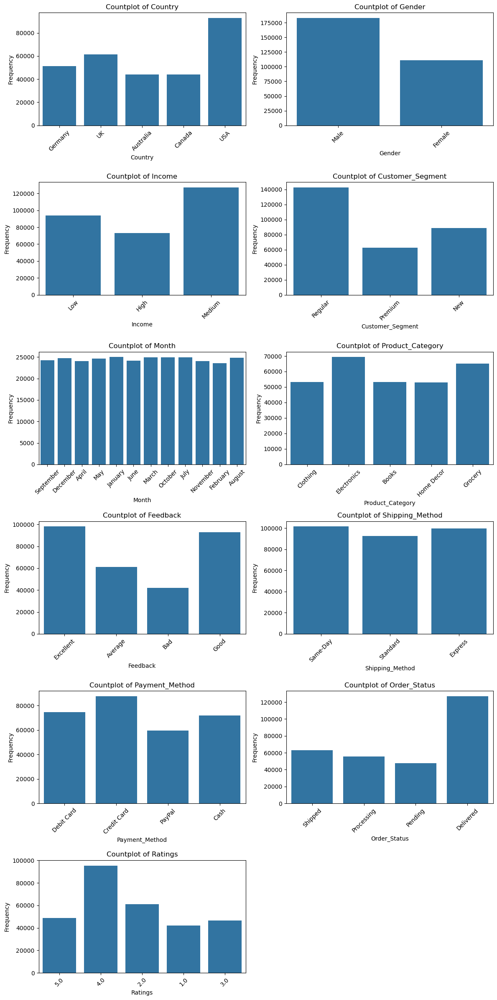

In [61]:
# Identify categorical columns and filter out the ones to remove
categorical_columns = df2.select_dtypes(include=[np.object_]).columns.to_list()
columns_to_remove = ['City', 'State', 'Product_Brand', 'Product_Type', 'products']
categorical_columns = [col for col in categorical_columns if col not in columns_to_remove]

# Set up the grid for subplots
n_cols = 2
n_rows = (len(categorical_columns) + 1) // n_cols  # Calculate rows needed
fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, n_rows * 4))
axes = axes.flatten()  # Flatten to make indexing simpler

# Plot count plots for each categorical column
for i, col in enumerate(categorical_columns):
    sns.countplot(data=df2, x=col, ax=axes[i])
    axes[i].set_title(f'Countplot of {col}')
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Frequency')
    axes[i].tick_params(axis='x', rotation=45)  # Rotate x-axis labels

# Remove any unused subplots in the grid
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Adjust layout for readability
plt.tight_layout()
plt.show()

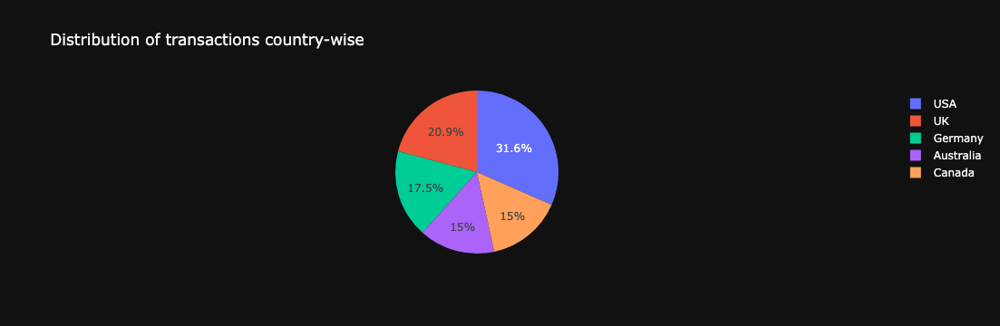

In [62]:
country_wise=df2['Country'].value_counts()
fig = px.pie(names=country_wise.index,values=country_wise.values, title='Distribution of transactions country-wise')
fig.show()

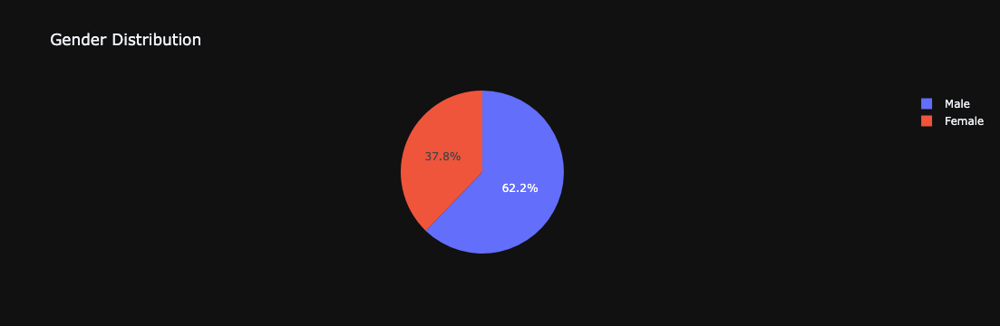

In [63]:
#gender counts
gender_counts=df2['Gender'].value_counts()
fig=px.pie(names=gender_counts.index,values=gender_counts.values,title='Gender Distribution')
fig.show()

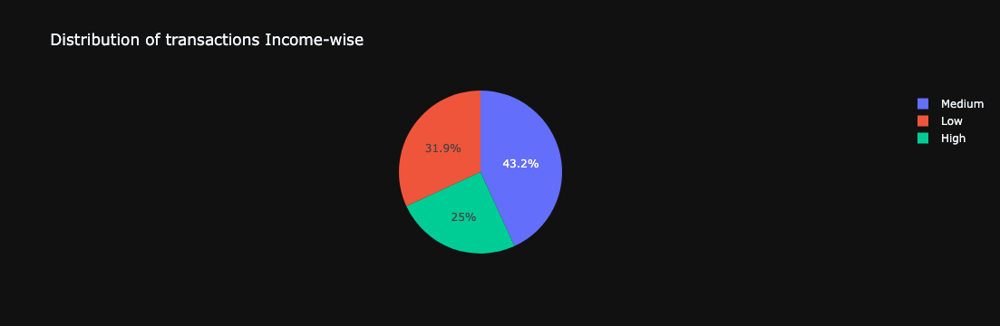

In [64]:
income_counts=df2['Income'].value_counts()
fig = px.pie(names=income_counts.index,values=income_counts.values, title='Distribution of transactions Income-wise')
fig.show()

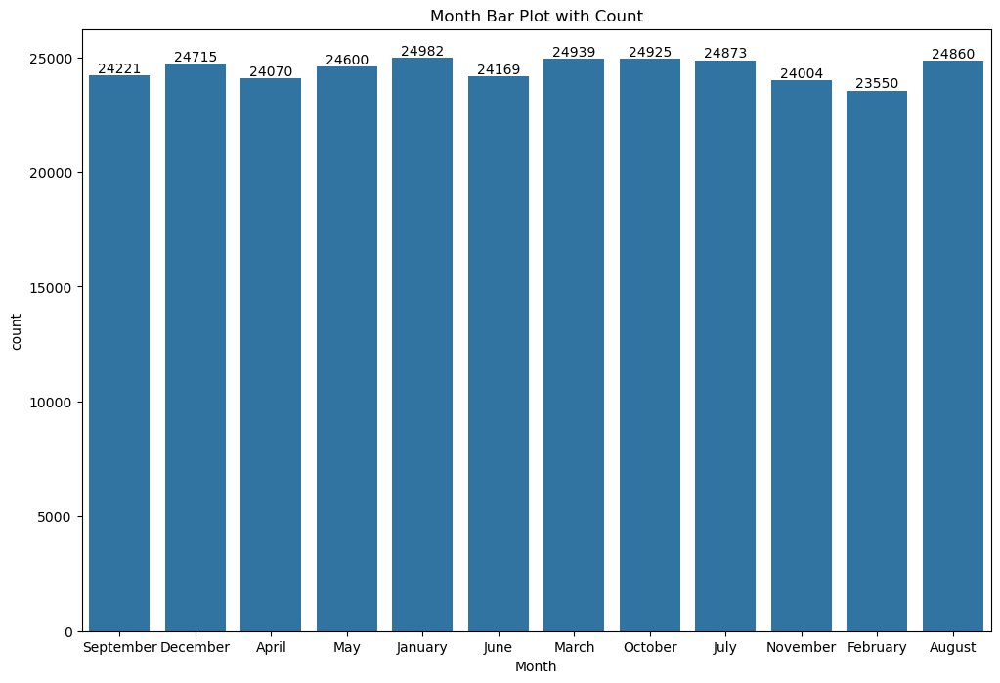

In [65]:
# month-wise sales 
gender = sns.countplot(x='Month', data=df2)
gender.bar_label(gender.containers[0])

# Add title and show plot
plt.title('Month Bar Plot with Count')
plt.show()

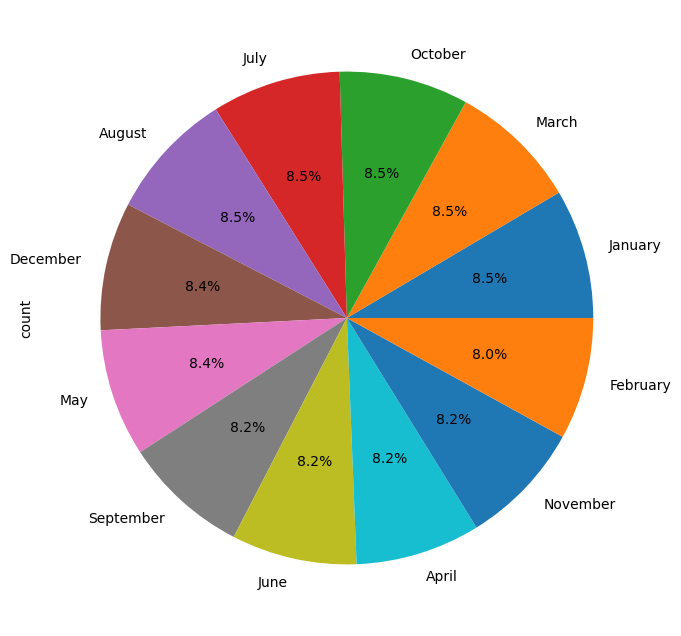

In [66]:
df2['Month'].value_counts().plot(kind='pie',autopct='%1.1f%%')
plt.show()

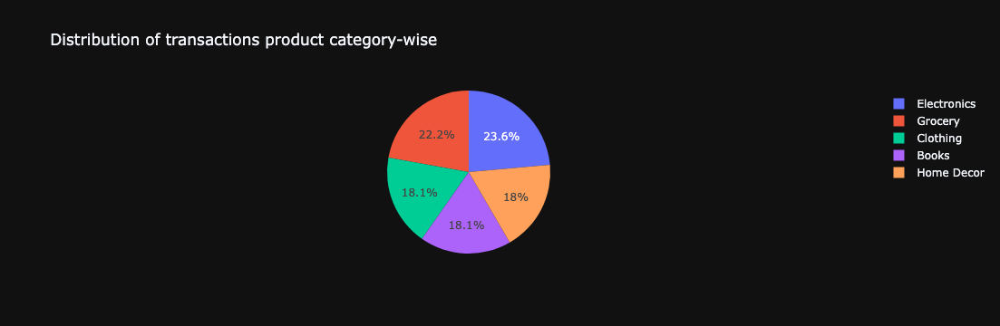

In [67]:
fig = px.pie(df2, names = 'Product_Category', title='Distribution of transactions product category-wise')
fig.show()

In [68]:
#Bivariate Analysis

In [69]:
#num vs num

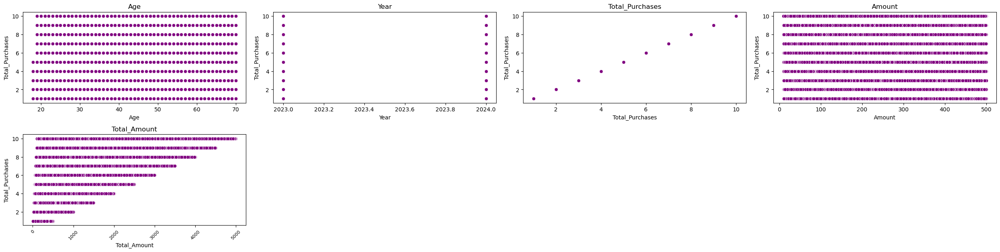

In [70]:
#num vs num
plt.rcParams['figure.figsize'] =[25,15]
j = 1
for i in df2[num]:
  plt.subplot(5, 4, j)
  sns.scatterplot(x=df2[num].loc[:, i],y=df2['Total_Purchases'],color='purple')
  plt.title(i)
  j += 1

plt.xticks(rotation=45, fontsize=8)
plt.tight_layout()
plt.show()

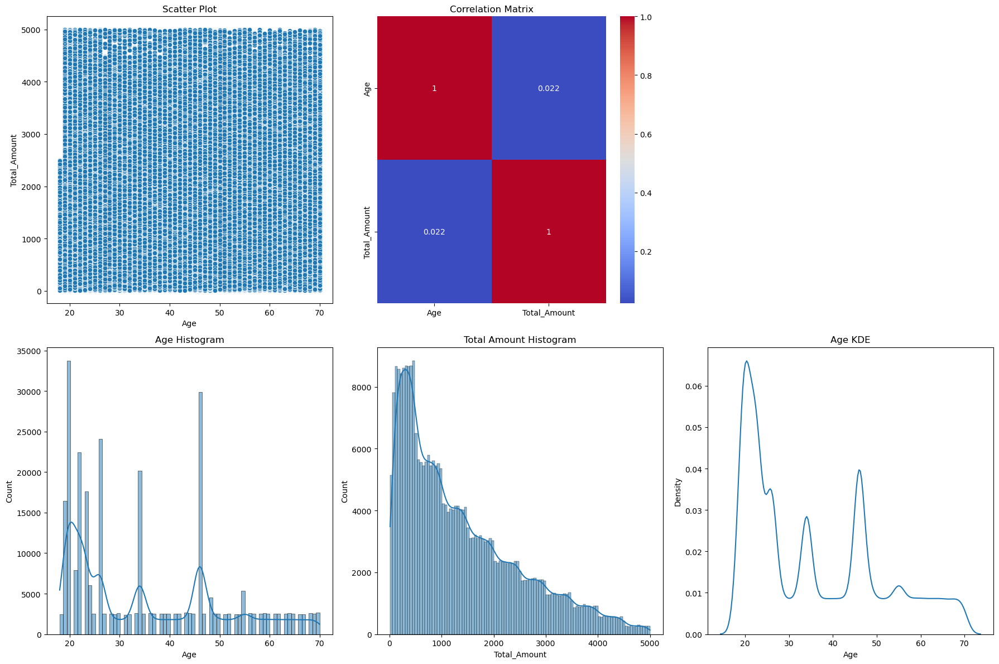

In [71]:
# 1- Age and total amount
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Scatter Plot
sns.scatterplot(x='Age', y='Total_Amount', data=df2, ax=axes[0, 0])
axes[0, 0].set_title('Scatter Plot')

# Correlation Matrix
corr = df2[['Age', 'Total_Amount']].corr()
sns.heatmap(corr, annot=True, cmap='coolwarm', ax=axes[0, 1])
axes[0, 1].set_title('Correlation Matrix')


# Histogram for Age
sns.histplot(data=df2, x='Age', kde=True, ax=axes[1, 0])
axes[1, 0].set_title('Age Histogram')

# Histogram for Total Purchases
sns.histplot(data=df2, x='Total_Amount', kde=True, ax=axes[1, 1])
axes[1, 1].set_title('Total Amount Histogram')

# Kernel Density Estimation Plot for Age
sns.kdeplot(data=df1, x='Age', ax=axes[1, 2])
axes[1, 2].set_title('Age KDE')
fig.delaxes(axes[0, 2])
plt.tight_layout()
plt.show()

In [72]:
# 2 total purchase and total amount

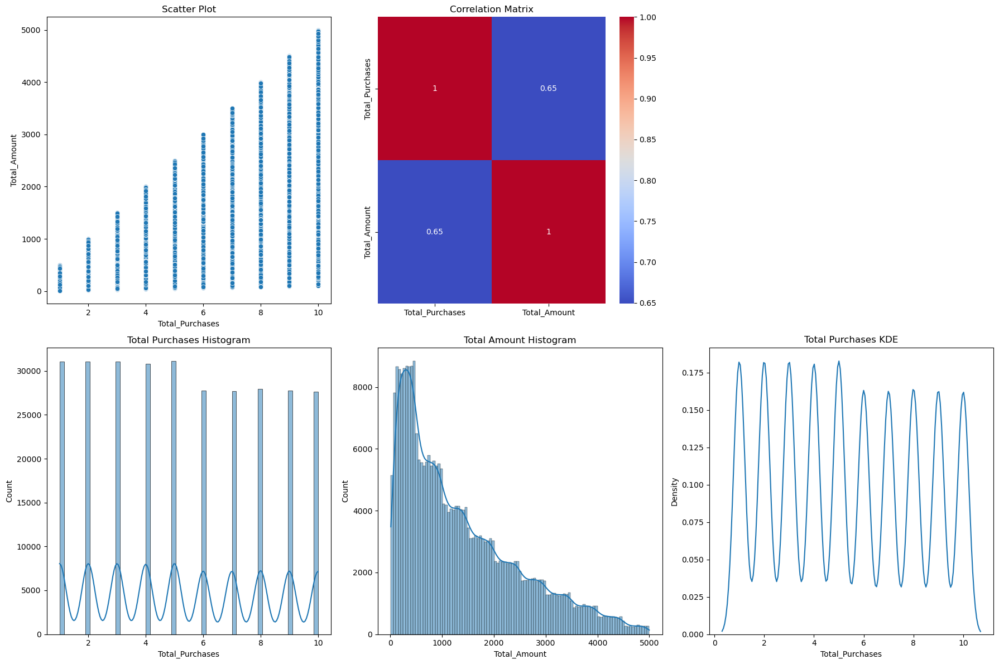

In [73]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Scatter Plot
sns.scatterplot(x='Total_Purchases', y='Total_Amount', data=df2, ax=axes[0, 0])
axes[0, 0].set_title('Scatter Plot')

# Correlation Matrix
corr = df2[['Total_Purchases', 'Total_Amount']].corr()
sns.heatmap(corr, annot=True, cmap='coolwarm', ax=axes[0, 1])
axes[0, 1].set_title('Correlation Matrix')

# Histogram for Total Purchases
sns.histplot(data=df2, x='Total_Purchases', kde=True, ax=axes[1, 0])
axes[1, 0].set_title('Total Purchases Histogram')

# Histogram for Total Amount
sns.histplot(data=df2, x='Total_Amount', kde=True, ax=axes[1, 1])
axes[1, 1].set_title('Total Amount Histogram')

# Kernel Density Estimation Plot for Total Purchases
sns.kdeplot(data=df2, x='Total_Purchases', ax=axes[1, 2])
axes[1, 2].set_title('Total Purchases KDE')

# Remove the empty subplot
fig.delaxes(axes[0, 2])
plt.tight_layout()
plt.show()

In [74]:
# cat vs cat

In [75]:
#1- state and country 
df2[['State','Country']].describe()

,State,Country
count,293908,293908
unique,54,5
top,England,USA
freq,61397,92800


In [76]:
#2- gender and customer segmentation

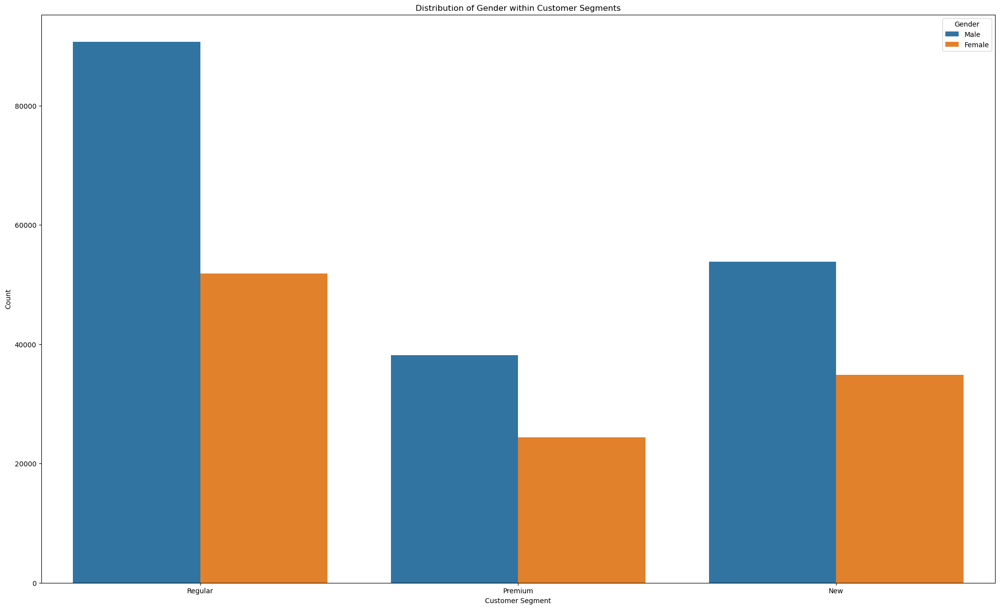

In [77]:
sns.countplot(data=df2, x='Customer_Segment', hue='Gender')
plt.title('Distribution of Gender within Customer Segments')
plt.xlabel('Customer Segment')
plt.ylabel('Count')
plt.legend(title='Gender')
plt.show()

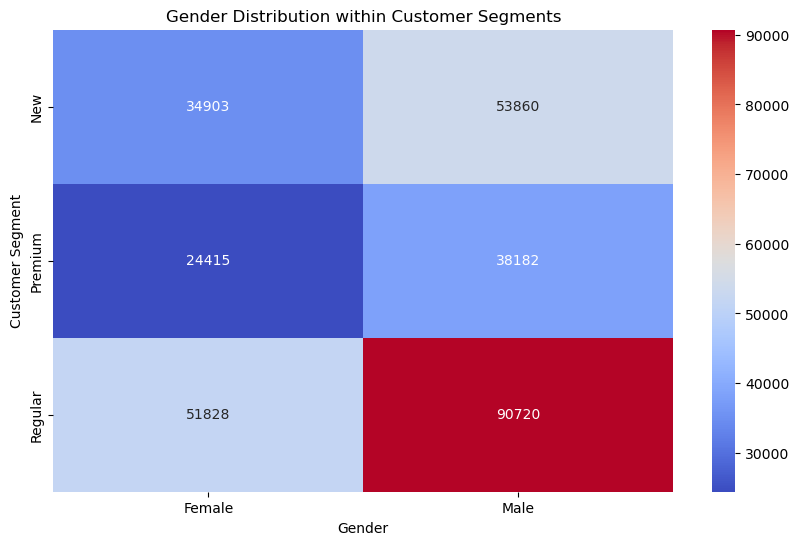

In [78]:
# Create a pivot table to aggregate counts
pivot_table = df2.pivot_table(index='Customer_Segment', columns='Gender', aggfunc='size')

# Create the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(pivot_table, annot=True, cmap='coolwarm', fmt='d')
plt.title('Gender Distribution within Customer Segments')
plt.xlabel('Gender')
plt.ylabel('Customer Segment')
plt.show()

### Customer Segment Distribution by Gender:

Regular Customers: Male customers are significantly higher in count compared to females.

Premium Customers: Male customers also dominate, but the gap is smaller than in the regular segment.

New Customers: Male customers still lead, but the female proportion is relatively closer compared to other segments.

### Business Insights
Regular Customers:

Since regular male customers dominate, introduce loyalty programs tailored to their preferences.
Explore campaigns targeted at female regular customers to boost their retention and engagement.

Premium Customers:

Identify the specific preferences and purchase behavior of male and female premium customers to enhance tailored offerings.
Create exclusive offers for females to attract more high-value customers into the premium category.

New Customers:

Focus on onboarding strategies that appeal to both genders equally, especially females, to balance the new customer acquisition.
Overall Gender Strategy:

Given the overall male dominance in all segments, consider expanding marketing and product lines that might attract more female customers.
Analyze potential gender-specific barriers (e.g., product appeal, website interface) that could be limiting female engagement.

In [80]:
#3- income and customer segments

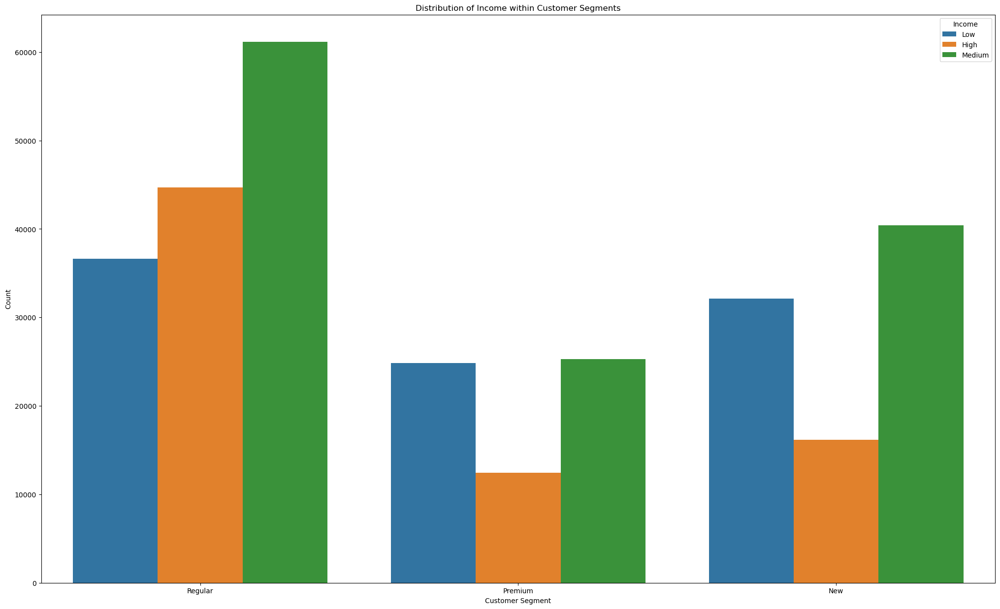

In [81]:
sns.countplot(data=df2, x='Customer_Segment', hue='Income')
plt.title('Distribution of Income within Customer Segments')
plt.xlabel('Customer Segment')
plt.ylabel('Count')
plt.legend(title='Income')
plt.show()

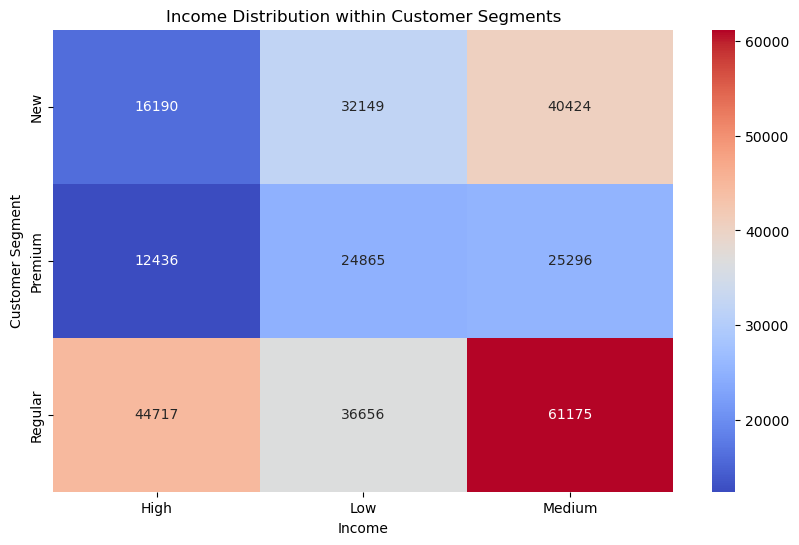

In [82]:
pivot_table = df2.pivot_table(index='Customer_Segment', columns='Income', aggfunc='size')

# Create the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(pivot_table, annot=True, cmap='coolwarm', fmt='d')
plt.title('Income Distribution within Customer Segments')
plt.xlabel('Income')
plt.ylabel('Customer Segment')
plt.show()

### Inference
New Customers: The majority have a medium income, followed by low-income and few high-income individuals.

Premium Customers: High-income individuals are most prevalent, indicating premium products attract wealthier customers.

Regular Customers: The medium-income group dominates, with high-income customers also contributing significantly.

### Business Insights
Targeting New Customers: The medium-income group is predominant, suggesting tailored marketing strategies with promotions that appeal to this segment. Expanding efforts to attract high-income individuals can help increase revenue.

Premium Segment Strategy: The strong presence of high-income customers in the premium segment means focusing on exclusive benefits for this group is essential. Offering more accessible premium options for medium and low-income customers can expand the base.

Regular Customer Growth: The medium-income group drives regular purchases. Enhancing loyalty programs or providing personalized services could deepen customer retention and engagement. High-income regular customers are also valuable, and personalized shopping experiences could encourage repeat business.

Revenue Optimization: Strategies that convert medium and low-income customers into premium or regular segments, such as tiered loyalty programs or special discounts, can drive growth.

Product Positioning: Adjust product offerings and pricing to align with the income distribution, focusing on affordable options to attract new customers and upselling premium services to existing medium-income buyers.

In [84]:
#4- Month and order status

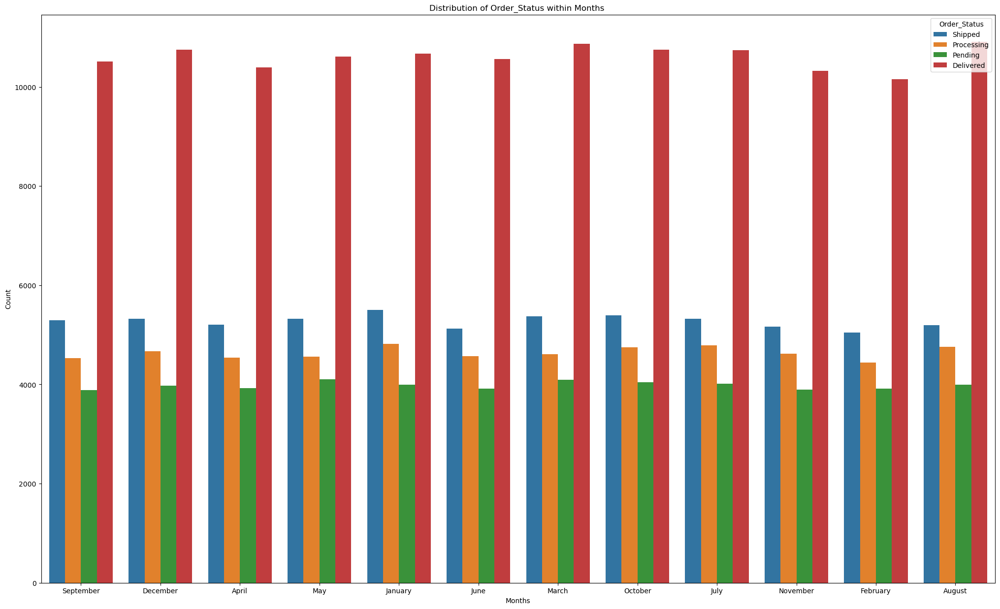

In [85]:
sns.countplot(data=df2, x='Month', hue='Order_Status')
plt.title('Distribution of Order_Status within Months ')
plt.xlabel('Months')
plt.ylabel('Count')
plt.legend(title='Order_Status')
plt.show()

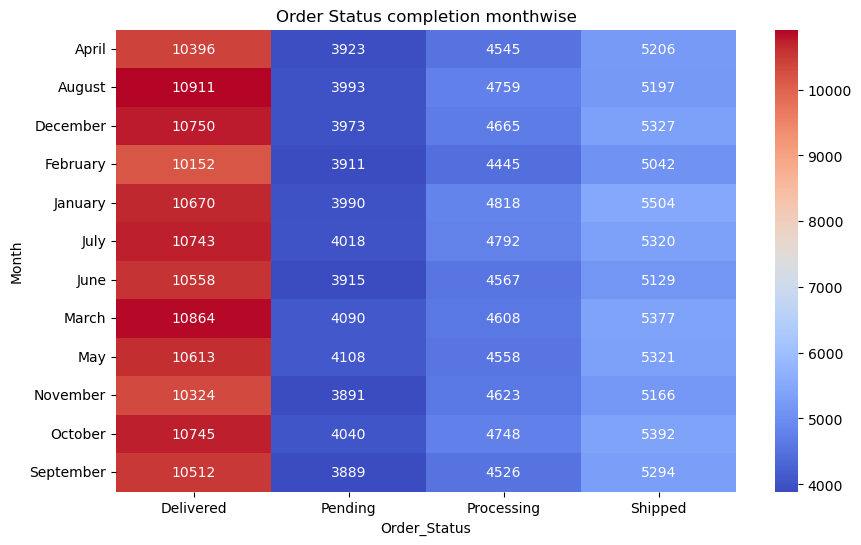

In [86]:
pivot_table = df2.pivot_table(index='Month', columns='Order_Status', aggfunc='size')

# Create the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(pivot_table, annot=True, cmap='coolwarm', fmt='d')
plt.title('Order Status completion monthwise')
plt.xlabel('Order_Status')
plt.ylabel('Month')
plt.show()

### Inference
Delivery Performance: The number of orders marked as "Delivered" varies, with April having the highest at 10,396 and November the lowest at 10,324.

Pending Orders: The highest count of pending orders was recorded in May (4,108), while the lowest was in April (3,923).

Processing Orders: The count for processing orders is relatively consistent across months, with a slight peak in January (4,818).

Shipped Orders: The month with the highest number of shipped orders was January (5,504), while the lowest was in February (5,042).

### Business Insights
Seasonal Trends: Delivery and shipping volumes remain relatively stable, with minor fluctuations. It may be beneficial to investigate peak order months and plan logistics and staffing accordingly to prevent delays.

Pending Orders Management: May shows the highest number of pending orders, suggesting that resources and process optimizations are needed during this period to reduce delays.

Efficiency in Processing: The processing phase is key, with January showing the highest count, indicating potential seasonal demand spikes. Enhancing processing time during peak months can improve overall efficiency.

Shipped Orders Focus: January has the highest number of shipped orders, signaling strong demand in the early months of the year. This could inform future marketing campaigns or inventory stocking strategies.

Order Fulfillment: Ensuring timely delivery and managing pending orders is crucial to maintaining customer satisfaction. Reviewing the peak times for pending and processing orders can lead to better logistics planning and operational efficiency.

In [88]:
#5- product category and product brand 

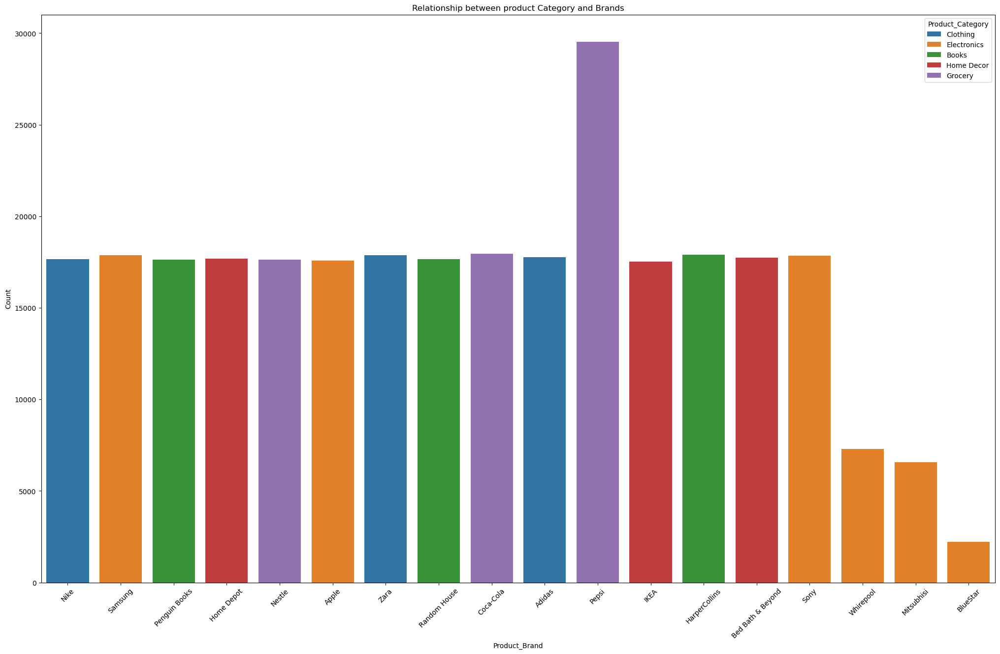

In [89]:
sns.countplot(data=df2, x='Product_Brand', hue='Product_Category')
plt.title('Relationship between product Category and Brands')
plt.xlabel('Product_Brand')
plt.ylabel('Count')
plt.legend(title='Product_Category')
plt.xticks(rotation=45)
plt.show()

The data shows the distribution of product counts across various brands and their respective product categories. Key insights include:

Top Performing Categories: The Grocery category has the highest product counts, with Pepsi leading at 29,537 products, followed by Coca-Cola (17,951) and Nestle (17,637). This suggests that grocery brands have strong product availability or a diverse range.

Leading Brands in Each Category:

Clothing: Zara (17,876) and Adidas (17,758) have the highest counts, indicating their significant presence in the clothing market.
Electronics: Samsung (17,866) and Sony (17,848) are prominent, showing robust sales and brand recognition in this category.
Home Decor: Brands like Bed Bath & Beyond (17,746) and Home Depot (17,673) have a strong foothold, suggesting a healthy consumer interest.
Books: Penguin Books (17,627) and HarperCollins (17,901) are leading, highlighting the steady demand for books.
Potential Opportunities: Brands with lower counts, such as BlueStar in electronics (2,208) and Whirlpool (7,289), may benefit from targeted marketing strategies to boost product visibility and sales.

Market Dominance: The data shows that well-established brands like Pepsi and Nike dominate their categories, indicating brand loyalty and market leadership. This can help businesses focus on partnerships with leading brands or evaluate competitive strategies in saturated categories.

Overall, this data can inform strategic decisions for inventory management, marketing campaigns, and expanding product lines to align with high-demand categories.

In [91]:
# 6 feedback and order status

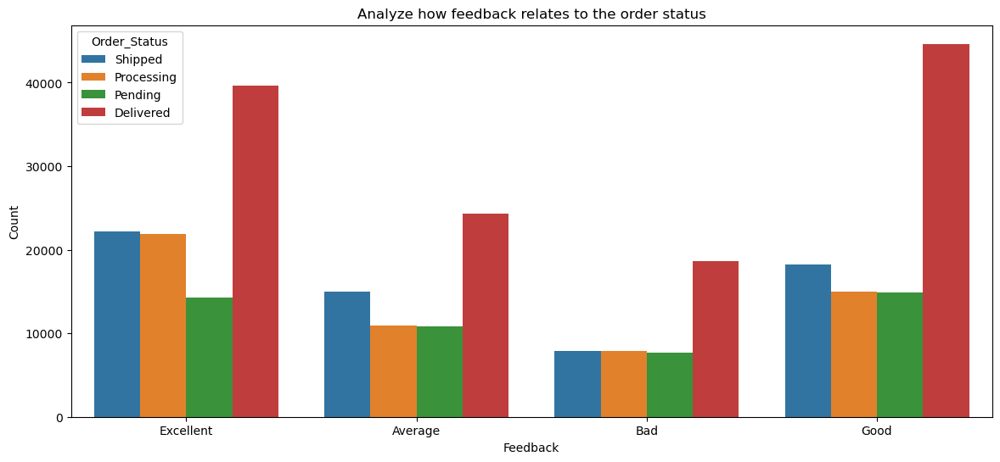

In [92]:
plt.figure(figsize=(14,6))
sns.countplot(data=df2, x='Feedback', hue='Order_Status')
plt.title('Analyze how feedback relates to the order status')
plt.xlabel('Feedback')
plt.ylabel('Count')
plt.legend(title='Order_Status')
plt.show()

The table shows the relationship between customer feedback and order status, revealing key business insights:

### Excellent Feedback: 
Customers who gave "Excellent" feedback have the highest order counts across all statuses, indicating strong satisfaction. Specifically, 39,625 orders were marked as "Delivered," 14,291 as "Pending," 21,937 as "Processing," and 22,163 as "Shipped." This suggests that the company is performing well in fulfilling orders for highly satisfied customers.

### Good Feedback: 
The "Good" category also shows high counts, with 44,644 orders delivered and relatively high numbers for other statuses. This suggests a positive but less enthusiastic experience than "Excellent," indicating room for improvement.

### Average Feedback: 
This category reflects a more mixed experience, with 24,285 "Delivered" orders, indicating that the company's performance may be adequate but not exceptional. The lower numbers for "Pending," "Processing," and "Shipped" suggest potential delays or issues that affect overall satisfaction.

### Bad Feedback: 
The "Bad" category shows the lowest order counts, with 18,684 "Delivered" orders. This implies that while the company can fulfill some orders marked "Bad," there are challenges in meeting expectations. The relatively high counts for "Pending," "Processing," and "Shipped" may indicate that customers in this category experience more issues with order fulfillment and delays.

### Business Implications: 
The company should focus on enhancing customer experiences that lead to "Average" and "Bad" feedback, improving order processing times and fulfillment reliability to increase customer satisfaction and loyalty.

In [94]:
#7-shipping method and payment method

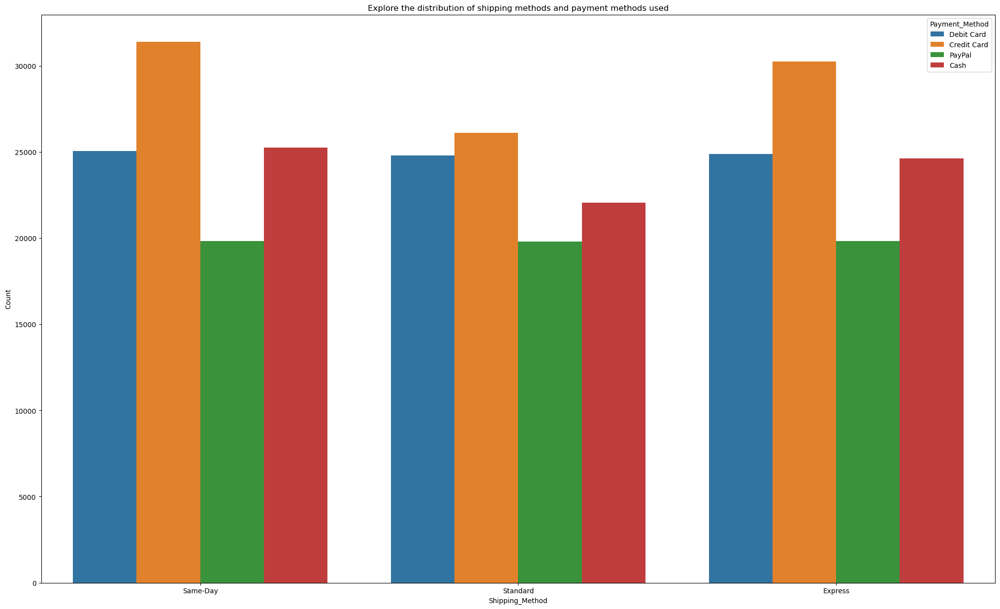

In [95]:
sns.countplot(data=df2, x='Shipping_Method', hue='Payment_Method')
plt.title('Explore the distribution of shipping methods and payment methods used')
plt.xlabel('Shipping_Method')
plt.ylabel('Count')
plt.legend(title='Payment_Method')
plt.show()

### Inference:

The table shows the distribution of payment methods across different shipping methods.

Same-Day Shipping: This method has the highest usage across all payment methods, particularly with credit cards (31,408 transactions) and cash (25,246 transactions). Customers may prefer faster delivery when paying with more secure or readily available methods.

Express Shipping: This is the second most popular shipping method, with slightly lower usage compared to Same-Day shipping. Credit cards (30,252 transactions) remain the dominant payment method for this option as well.

Standard Shipping: This method is the least utilized among the three, with fewer transactions across all payment methods. However, the distribution of payment methods remains relatively consistent with the other shipping types, showing a preference for credit cards and cash.

### Business Insights:

Customer Preferences for Credit Cards: Credit cards are the most commonly used payment method across all shipping methods, indicating customer trust in this method for both faster (Same-Day/Express) and slower (Standard) deliveries. Offering promotional incentives, such as cashback or discounts for credit card users, could boost sales further.

Cash Usage in Fast Shipping: A significant number of customers use cash for Same-Day and Express shipping. This suggests that many users may opt for Cash on Delivery (COD) when they require urgent deliveries. Strengthening COD logistics for faster shipping could enhance customer satisfaction.

Standard Shipping Popularity: The comparatively lower use of standard shipping methods highlights a potential shift in customer demand toward faster delivery options. Businesses may consider optimizing their standard shipping service to attract more budget-conscious or less time-sensitive customers.
These insights can help tailor marketing strategies and improve payment and shipping policies.

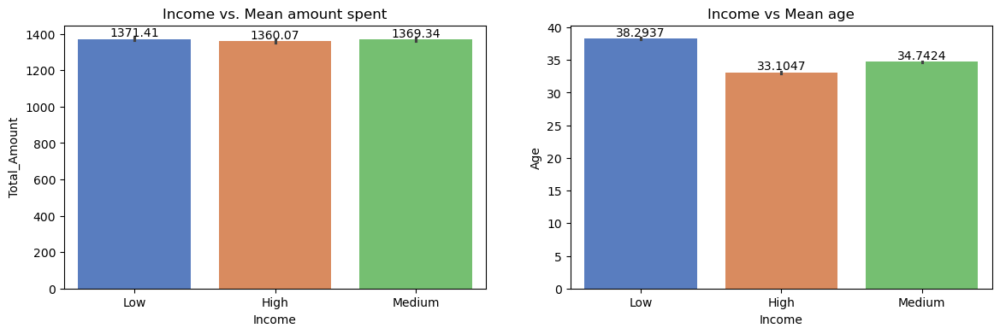

In [97]:
f,axes = plt.subplots(1,2,figsize=(14,4))
ax = sns.barplot(x = df2['Income'], y=df2['Total_Amount'],palette= 'muted', ax=axes[0])
ax.set_title("Income vs. Mean amount spent")
for i in ax.containers:
    ax.bar_label(i)
ax = sns.barplot(x = df2['Income'], y=df2['Age'],palette='muted',ax=axes[1])
ax.set_title("Income vs Mean age")
for i in ax.containers:
    ax.bar_label(i)

#### Inference-6
- Feedback column is redundant as it reflects the ratings given
- Pending orders have least mean rating as expected.

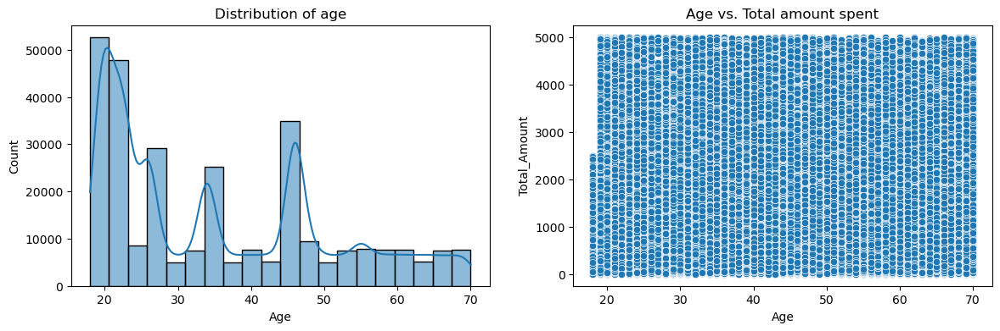

In [99]:
#age and total amount
f,axes = plt.subplots(1,2,figsize=(14,4))
ax = sns.scatterplot(x = df2['Age'], y=df2['Total_Amount'],ax=axes[1])
ax.set_title("Age vs. Total amount spent")
ax = sns.histplot(x = df1['Age'], bins=20, kde=True,ax=axes[0])
ax.set_title("Distribution of age")
plt.show()

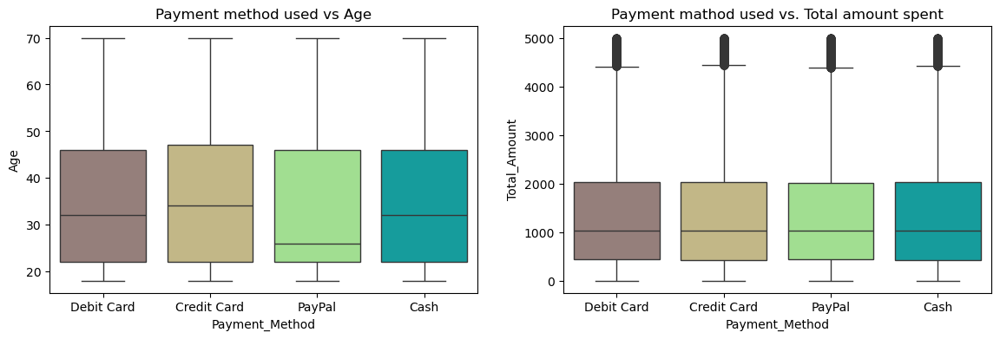

In [100]:
f,axes = plt.subplots(1,2,figsize=(14,4))
ax = sns.boxplot(x = df2['Payment_Method'], y=df2['Total_Amount'],palette = 'terrain_r', ax=axes[1])
ax.set_title("Payment mathod used vs. Total amount spent")
ax = sns.boxplot(x = df2['Payment_Method'], y=df2['Age'],palette = 'terrain_r',ax=axes[0])
ax.set_title("Payment method used vs Age")
plt.show()

- All customer segments are have similar mean spending
- It can be seen that Premium segment has the highest mean age whereas the Regular segment has the lowest mean age

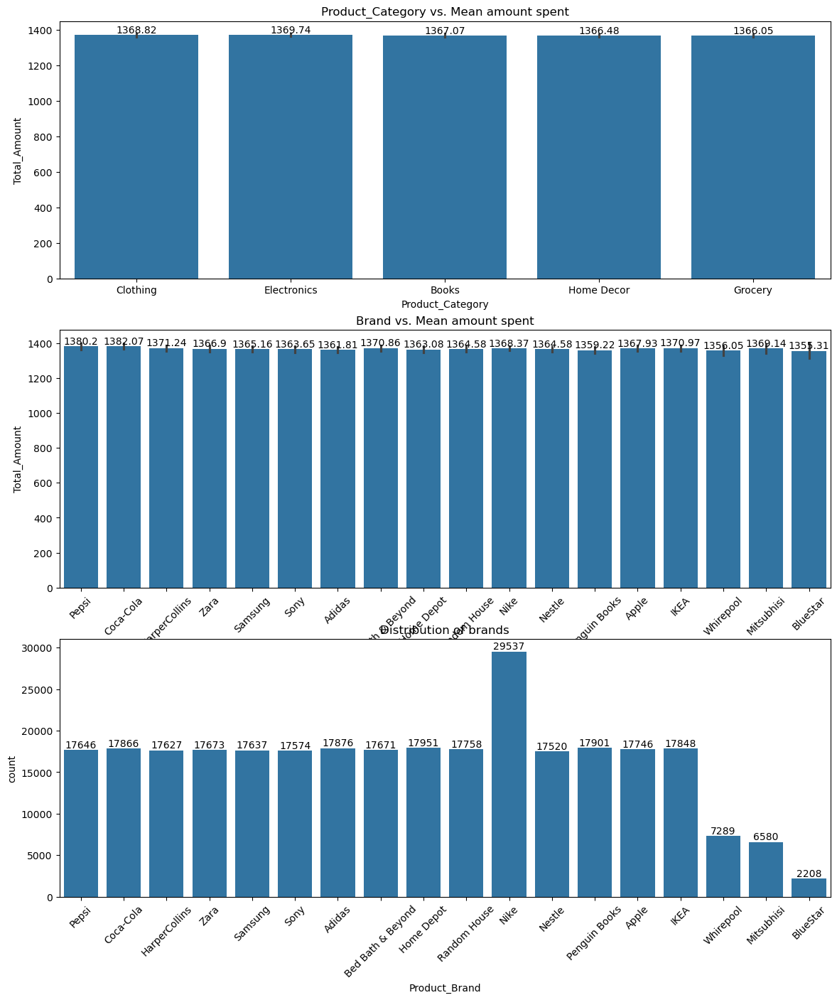

In [102]:
f,axes = plt.subplots(3,1,figsize=(14,16))
ax = sns.barplot(x = df2['Product_Category'], y=df2['Total_Amount'],ax=axes[0])
ax.set_title("Product_Category vs. Mean amount spent")
for i in ax.containers:
    ax.bar_label(i)
ax = sns.barplot(x = df2['Product_Brand'], y=df2['Total_Amount'],ax=axes[1])
ax.set_title("Brand vs. Mean amount spent")
ax.set_xticklabels(labels = list(dict(df2['Product_Brand'].value_counts()).keys()), rotation=45)
for i in ax.containers:
    ax.bar_label(i)
ax = sns.countplot(x = df2['Product_Brand'],ax=axes[2])
ax.set_title("Distribution of brands")
ax.set_xticklabels(labels = list(dict(df2['Product_Brand'].value_counts()).keys()), rotation=45)
for i in ax.containers:
    ax.bar_label(i)

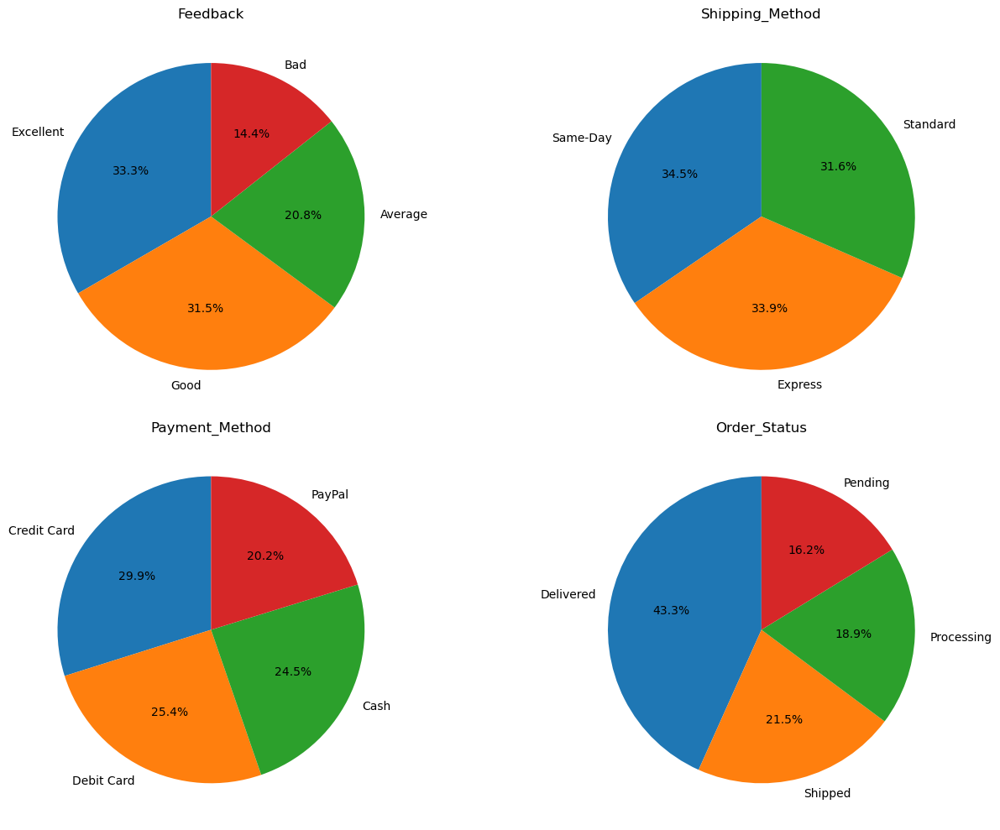

In [103]:
#Checking distribution of few more categorical variables
data = df2[['Feedback', 'Shipping_Method', 'Payment_Method',
       'Order_Status']]

# Get unique feature names
features = data.columns

# Create subplots
fig, axs = plt.subplots(2, 2, figsize=(14, 10))

# Flatten the axs array for easier indexing
axs = axs.flatten()

# Plot pie charts for each feature
for i, feature in enumerate(features):
    # Count occurrences of True and False
    counts = data[feature].value_counts()
    labels = counts.index
    sizes = counts.values

    # Plot pie chart
    axs[i].pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)
    axs[i].set_title(feature)

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

Text(0.5, 1.0, 'Customer segment vs. Age')

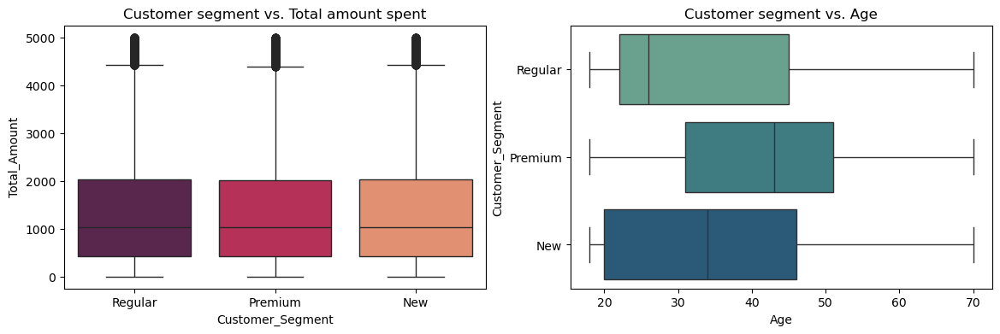

In [104]:
f,axes = plt.subplots(1,2,figsize=(14,4))
ax = sns.boxplot(x = df1['Customer_Segment'], y=df1['Total_Amount'],palette = 'rocket', ax=axes[0])
ax.set_title("Customer segment vs. Total amount spent")
ax = sns.boxplot(y = df1['Customer_Segment'], x=df1['Age'],palette = 'crest', orient='h',ax=axes[1])
ax.set_title("Customer segment vs. Age")

In [105]:
df2['Date'] = pd.to_datetime(df1['Date'])
df2['Day'] = df2['Date'].dt.day
df2['Day_name'] = df2['Date'].dt.day_name()

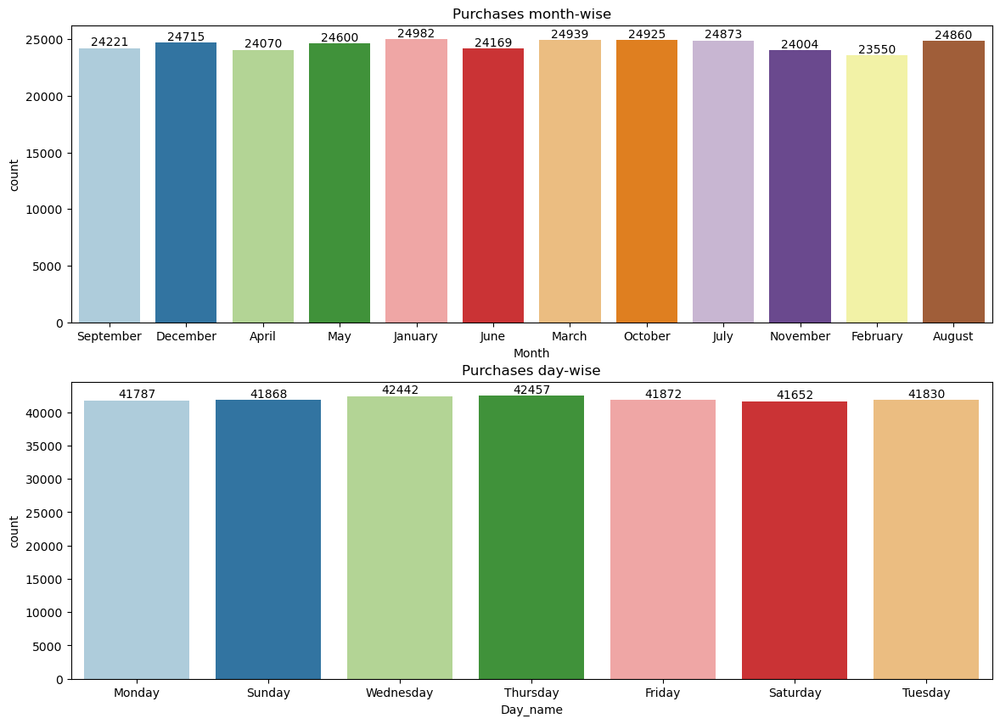

In [106]:
f,axes = plt.subplots(2,1,figsize=(14,10))
ax = sns.countplot(x = df2['Month'],palette='Paired', ax=axes[0])
ax.set_title("Purchases month-wise")
for i in ax.containers:
    ax.bar_label(i)
ax = sns.countplot(x = df2['Day_name'],palette='Paired',ax=axes[1])
ax.set_title("Purchases day-wise")
for i in ax.containers:
    ax.bar_label(i)
plt.show()

- The month of April has highest number of transactions followed by August
- All days of the week have similar number of transactions with Thursday being slightly higher than the rest.

In [108]:
df2['Month_Year'] = df2['Date'].dt.to_period('M')

Text(0.5, 1.0, 'Total amount spent on each product category')

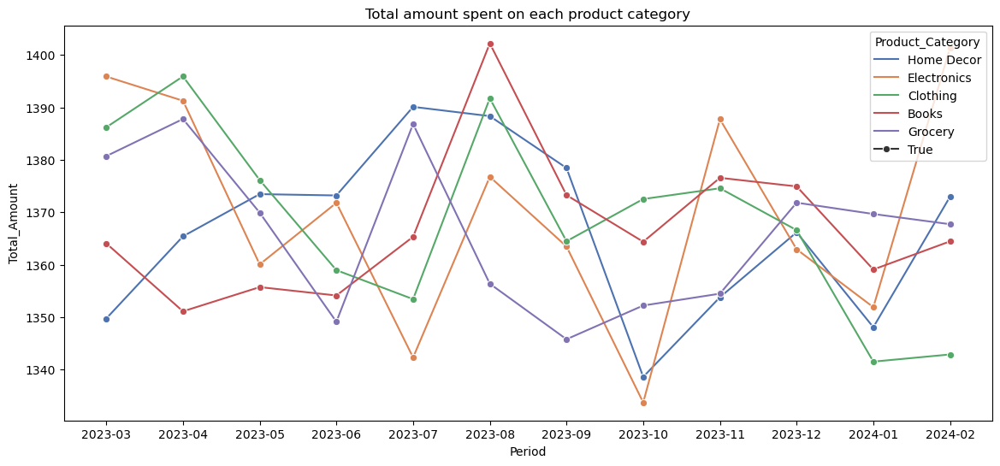

In [109]:
df2['Period'] = df2['Month_Year'].astype(str)
df_sorted = df2.sort_values('Period')
plt.figure(figsize=(14,6))
sns.lineplot(x = df_sorted['Period'], y = df_sorted['Total_Amount'], hue=df_sorted['Product_Category'],err_style=None, style=True, markers=True, palette='deep').set_title("Total amount spent on each product category")

-  More transaction are happening from the US. Males are more in number than females. More transactions are being done by the Medium income customers.

- More customers are below the age of 30. The mean age is low for high income customers and it is high for low income customers.

-  There appears to be no correlation between age and amount being spent.  The mean age is least for customers using PayPal for payment and highest for customers using credit card.

- Electronics are the most popular product category. The mean amount spent on all product categories or brands are the similar. But the number of orders for Nike is maximum and BlueStar is minimum. 

- There is only 14% of bad feedback.

-  Credit and debit cards are more frequently used for making payments. The mean amount spent on all payment methods are similar. 

- All three shipping methods are equally popular. More orders have been delivered. Around 16% of the orders are in pending status. Pending orders have least mean rating as expected.

- The month of April has highest number of transactions followed by August. All days of the week have similar number of transactions with Thursday being slightly higher than the rest. We cannot pinpoint to any seasonal pattern in shopping based on the visuals.

- All customer segments are have similar mean spending. It can be seen that Premium segment has the highest mean age whereas the Regular segment has the lowest mean age. 

In [111]:
#Customer Segmentation using RFM approach

RFM : Recency-Frequency-Monetary
These are the 3 main attributes by which we can segment our customers for better advertising as well as customer service.

Recency: How recently the customer has made purchases. A customer who is more recent has better value for the business and their feedback has higher impact.
Frequency : How frequently a particular customer has made purchases. Naturally, these are loyal customers and new discounts or offers can be given to such customers.
Monetary: How much money is a customer spending on his purchases. The higher the spending, the more valuable the customer is

In [113]:
rfm = df1[['Customer_ID', 'Total_Amount','Date','Transaction_ID']]

In [114]:
# Monetary
rfm_m = rfm.groupby('Customer_ID')['Total_Amount'].sum()
rfm_m = rfm_m.reset_index()
rfm_m.columns = ['Customer_ID', 'Monetary']
rfm_m.head()

,Customer_ID,Monetary
0,10000.0,5007.566359
1,10001.0,8136.462822
2,10002.0,4104.013951
3,10003.0,2340.496446
4,10004.0,2356.516683


In [115]:
#Frequency

rfm_f = rfm.groupby('Customer_ID')['Transaction_ID'].count()
rfm_f = rfm_f.reset_index()
rfm_f.columns = ['Customer_ID', 'Frequency']
rfm_f.head()

,Customer_ID,Frequency
0,10000.0,4
1,10001.0,5
2,10002.0,5
3,10003.0,2
4,10004.0,2


In [116]:
#Recency

rfm['Days_diff'] = max(rfm['Date']) - rfm['Date']
rfm_r = rfm.groupby('Customer_ID')['Days_diff'].min()
rfm_r = rfm_r.reset_index()
rfm_r.columns = ['Customer_ID', 'Recency']
rfm_r['Recency'] = rfm_r['Recency'].dt.days
rfm_r.head()

,Customer_ID,Recency
0,10000.0,102
1,10001.0,104
2,10002.0,94
3,10003.0,227
4,10004.0,30


In [117]:
#Combining all columns into a single dataframe
rfm_final = rfm[['Customer_ID']]
rfm_final = pd.merge(rfm_final, rfm_r, on='Customer_ID', how='inner')
rfm_final = pd.merge(rfm_final, rfm_f, on='Customer_ID', how='inner')
rfm_final = pd.merge(rfm_final, rfm_m, on='Customer_ID', how='inner')
rfm_final.head()

,Customer_ID,Recency,Frequency,Monetary
0,37249.0,23,5,6485.389527
1,69749.0,0,5,4089.881243
2,30192.0,127,4,7337.481178
3,62101.0,50,3,7936.809742
4,27901.0,27,3,1334.931576


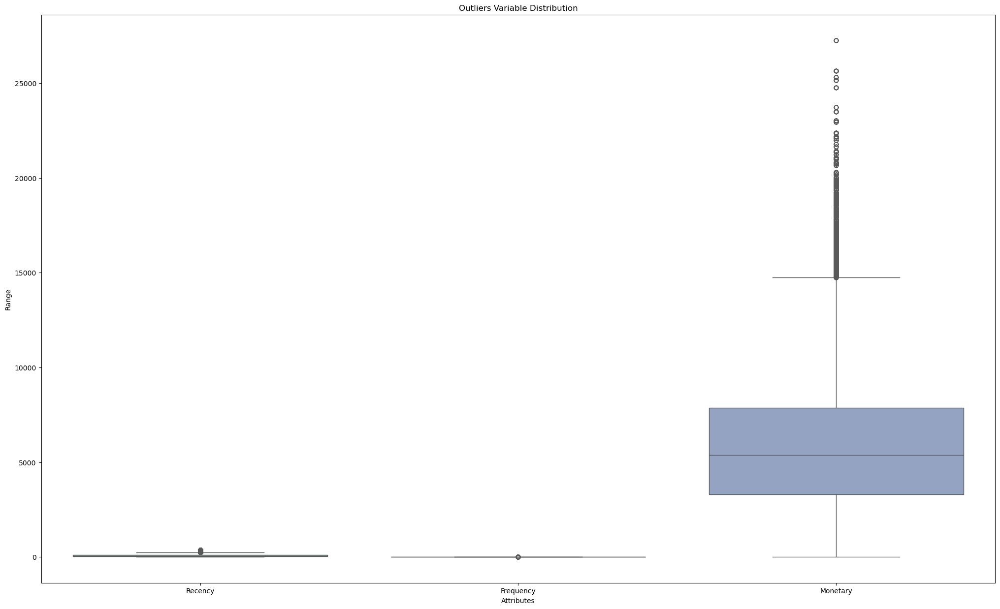

In [118]:
attributes = ['Recency','Frequency','Monetary']
sns.boxplot(data = rfm_final[attributes], orient="v", palette="Set2")
plt.title("Outliers Variable Distribution")
plt.ylabel("Range")
plt.xlabel("Attributes")
plt.show()

In [119]:
# Removing outliers for Monetary
Q1 = rfm_final.Monetary.quantile(0.05)
Q3 = rfm_final.Monetary.quantile(0.95)
IQR = Q3 - Q1
rfm_final = rfm_final[(rfm_final.Monetary >= Q1 - 1.5*IQR) & (rfm_final.Monetary <= Q3 + 1.5*IQR)]

# Removing outliers for Recency
Q1 = rfm_final.Recency.quantile(0.05)
Q3 = rfm_final.Recency.quantile(0.95)
IQR = Q3 - Q1
rfm_final = rfm_final[(rfm_final.Recency >= Q1 - 1.5*IQR) & (rfm_final.Recency <= Q3 + 1.5*IQR)]

# Removing outliers for Frequency
Q1 = rfm_final.Frequency.quantile(0.05)
Q3 = rfm_final.Frequency.quantile(0.95)
IQR = Q3 - Q1
rfm_final = rfm_final[(rfm_final.Frequency >= Q1 - 1.5*IQR) & (rfm_final.Frequency <= Q3 + 1.5*IQR)]

#### Why Remove Outliers in RFM Segmentation

- **Impact on Clustering**:  
  Outliers can skew results in distance-based clustering algorithms like K-Means, DBSCAN, or GMM, leading to inaccurate clusters. For example:  
  - High Monetary outliers can dominate centroids.  
  - Low Recency outliers can distort cluster assignments.  

- **Improved Feature Scaling**:  
  Outliers can distort standardization, making scaled features less meaningful.

- **Business Focus**:  
  Outliers often represent edge cases (e.g., one-off high-value or inactive customers) and may not be relevant for actionable insights. Removing them ensures clusters represent typical customer behavior.

In [121]:
# Standardization
rfm_df = rfm_final[['Monetary', 'Frequency', 'Recency']]

# Instantiate
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

# fit_transform
rfm_df_scaled = scaler.fit_transform(rfm_df)
rfm_df_scaled.shape

(293908, 3)

In [122]:
rfm_df_scaled = pd.DataFrame(rfm_df_scaled)
rfm_df_scaled.columns = ['Monetary', 'Frequency', 'Recency']
rfm_df_scaled.head()

,Monetary,Frequency,Recency
0,0.184915,0.392311,-0.781287
1,-0.514257,0.392311,-1.103157
2,0.433613,-0.155329,0.674128
3,0.608538,-0.702968,-0.403439
4,-1.318338,-0.702968,-0.725309


- The scaled values of **Monetary**, **Frequency**, and **Recency** now fall within a similar range, centered around 0. This ensures that all features contribute equally to the clustering process, preventing dominance by any one variable.

- Without scaling, features like Monetary (often higher in magnitude) would dominate the clustering process, leading to biased clusters. Standardization ensures all RFM components are treated fairly during distance calculations. 

In [124]:
#K-means Clustering

In [125]:
from sklearn.cluster import KMeans

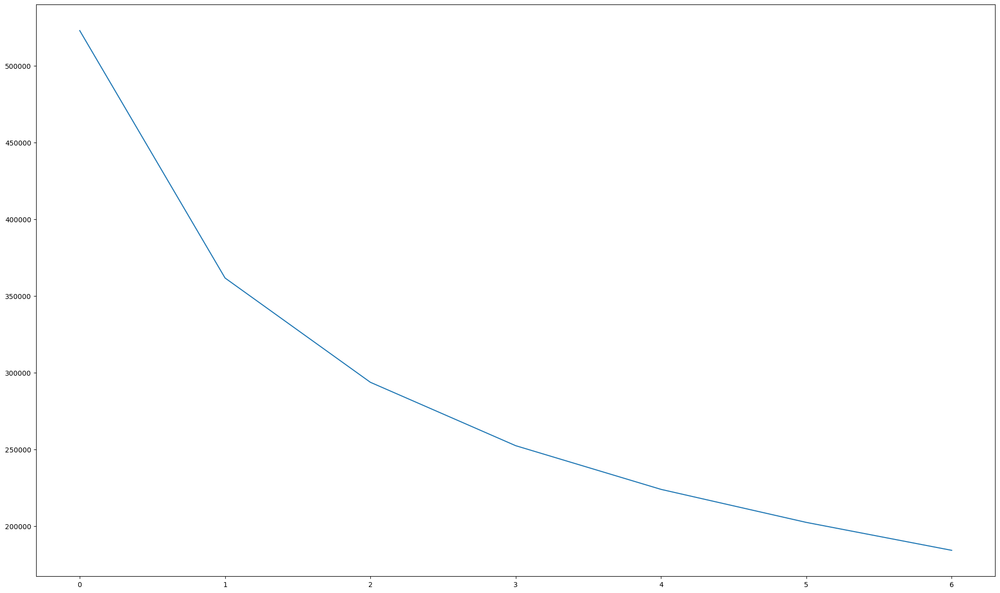

In [126]:
#Plotting elbow curve for optimum number of clusters
wcss = []
range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
for num_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
    kmeans.fit(rfm_df_scaled)
    
    wcss.append(kmeans.inertia_)    

plt.plot(wcss)

In [127]:
from sklearn.metrics import silhouette_score

In [128]:
from sklearn.metrics import davies_bouldin_score
range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for num_clusters in range_n_clusters:
    
    # intialise kmeans
    kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
    kmeans.fit(rfm_df_scaled)
    
    cluster_labels = kmeans.labels_
    
    # davies-bouldin score
    db_avg = davies_bouldin_score(rfm_df_scaled, cluster_labels)
    print(f"For n_clusters={num_clusters}, the Davies-Bouldin score is {db_avg}")

For n_clusters=2, the Davies-Bouldin score is 1.0706904014707619
For n_clusters=3, the Davies-Bouldin score is 0.9716631354683841
For n_clusters=4, the Davies-Bouldin score is 1.0626578056212679
For n_clusters=5, the Davies-Bouldin score is 1.034596221926281
For n_clusters=6, the Davies-Bouldin score is 1.0766767086113043
For n_clusters=7, the Davies-Bouldin score is 1.0670283226962445
For n_clusters=8, the Davies-Bouldin score is 1.0641234623681954


In [129]:
# Final model with k=3
kmeans = KMeans(n_clusters=3, max_iter=50)
kmeans.fit(rfm_df_scaled)

KMeans(max_iter=50, n_clusters=3)

In [130]:
 kmeans.labels_

array([0, 0, 0, ..., 0, 1, 0], dtype=int32)

In [131]:
#Calculating Metrics
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import calinski_harabasz_score

db_index = davies_bouldin_score(rfm_df_scaled, kmeans.labels_)
ch_index = calinski_harabasz_score(rfm_df_scaled, kmeans.labels_)

print(f'Davies-Bouldin Score : {db_index}')
print(f'Calinski-Harabasz Score : {ch_index}')


Davies-Bouldin Score : 0.9717302866765959
Calinski-Harabasz Score : 211289.08559002762


In [132]:
# assign the label
rfm_final['Cluster_Id'] = kmeans.labels_
rfm_final.head()

,Customer_ID,Recency,Frequency,Monetary,Cluster_Id
0,37249.0,23,5,6485.389527,0
1,69749.0,0,5,4089.881243,0
2,30192.0,127,4,7337.481178,0
3,62101.0,50,3,7936.809742,0
4,27901.0,27,3,1334.931576,0


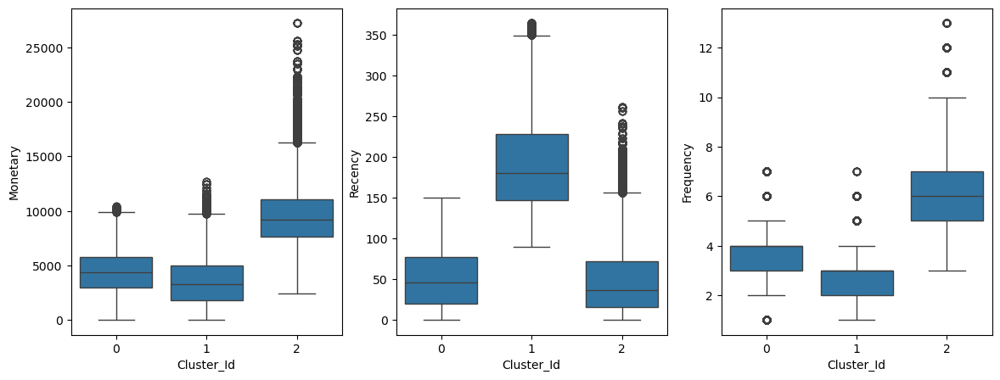

In [133]:
# Box plot to visualize Cluster Ids
f,axes = plt.subplots(1,3,figsize=(14,5))

sns.boxplot(x='Cluster_Id', y='Monetary', data=rfm_final, ax=axes[0])
sns.boxplot(x='Cluster_Id', y='Recency', data=rfm_final, ax=axes[1])
sns.boxplot(x='Cluster_Id', y='Frequency', data=rfm_final, ax=axes[2])
plt.show()

In [134]:
# Profiling clusters
cluster_profiles = rfm_final.groupby('Cluster_Id').mean()  # Calculate the mean for all features by cluster
print("Cluster Profiles:\n", cluster_profiles)

# Save cluster profiles to a CSV (optional)
cluster_profiles.to_csv("cluster_profiles.csv", index=True)

Cluster Profiles:
              Customer_ID     Recency  Frequency     Monetary
Cluster_Id                                                  
0           54813.321169   50.588777   3.648730  4360.845096
1           55055.231155  192.262047   2.726877  3551.688862
2           55291.703766   49.199153   6.245419  9591.373970


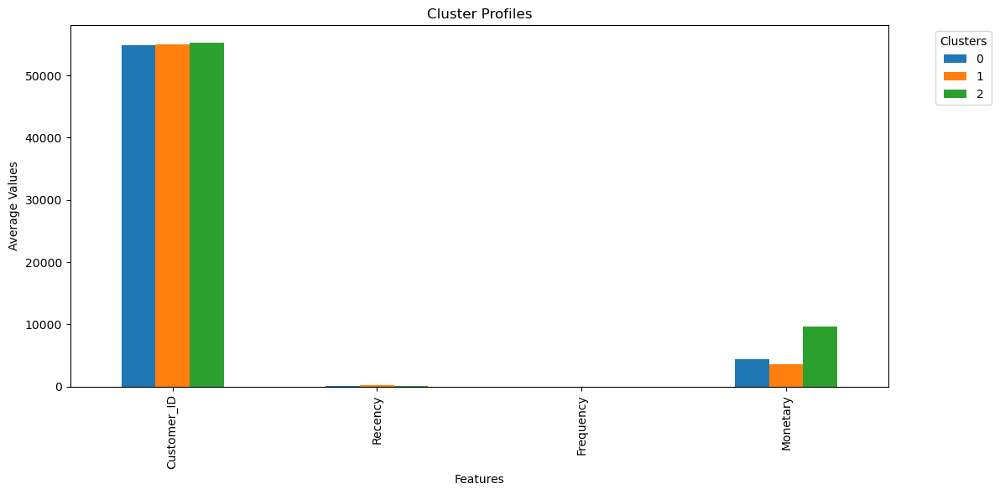

In [135]:
import matplotlib.pyplot as plt

# Bar chart for cluster profiles
cluster_profiles.T.plot(kind='bar', figsize=(12, 6))
plt.title("Cluster Profiles")
plt.ylabel("Average Values")
plt.xlabel("Features")
plt.legend(title="Clusters", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

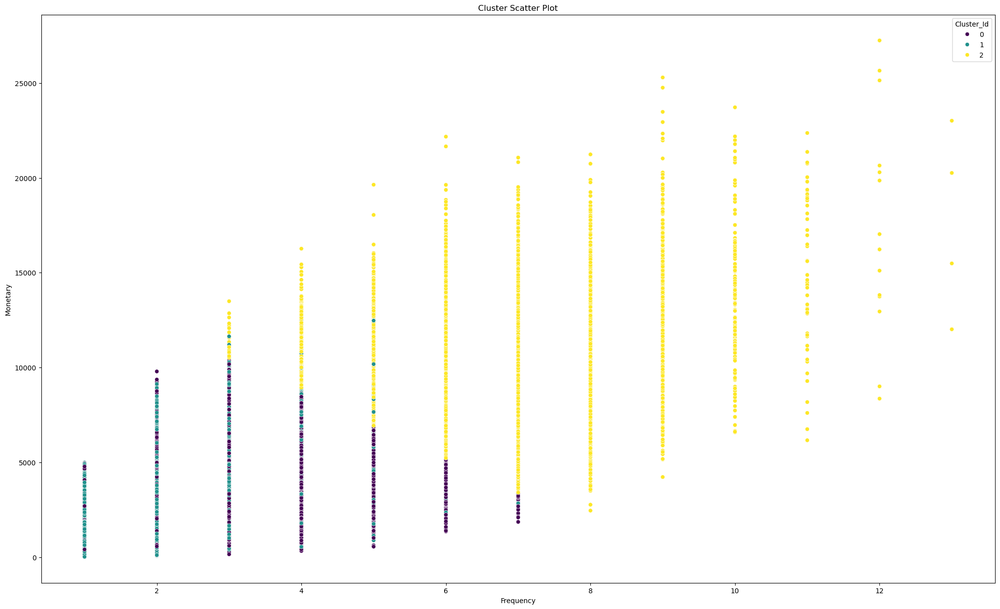

In [136]:
import seaborn as sns

sns.scatterplot(data=rfm_final, x='Frequency', y='Monetary', hue='Cluster_Id', palette='viridis')
plt.title("Cluster Scatter Plot")
plt.show()

In [137]:
# The cluster scatter plot reveals three distinct groups of data points:
# Cluster 0: These points have the highest Monetary values, spanning a wide range of Frequency. This cluster likely represents the most valuable customer segment.
# Cluster 1: The points in this cluster have moderate to high Monetary values and are concentrated in the mid-range of Frequency. This could be a core customer segment.
# Cluster 2: These data points have the lowest Monetary values and are distributed across the Frequency range. This cluster may represent less valuable or less engaged customers.

### PCA for Dimensionality reduction 

In [139]:
#Check for multicolinearity

In [140]:
correlation_matrix = rfm_final.corr()
correlation_matrix

,Customer_ID,Recency,Frequency,Monetary,Cluster_Id
Customer_ID,1.000000,-0.001306,0.003327,0.008260,0.008076
Recency,-0.001306,1.000000,-0.390726,-0.277992,0.067203
Frequency,0.003327,-0.390726,1.000000,0.722822,0.577863
Monetary,0.008260,-0.277992,0.722822,1.000000,0.631982
Cluster_Id,0.008076,0.067203,0.577863,0.631982,1.000000


In [142]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

def calculate_vif(dataframe):
    vif_data = pd.DataFrame()
    vif_data["Variable"] = dataframe.columns
    vif_data["VIF"] = [variance_inflation_factor(dataframe.values, i) for i in range(dataframe.shape[1])]
    return vif_data

print(calculate_vif(rfm_final))

      Variable        VIF
0  Customer_ID   4.141407
1      Recency   1.941562
2    Frequency  10.671715
3     Monetary   9.631946
4   Cluster_Id   3.475477


In [ ]:
#VIF values are above 5-10, it indicates high multicollinearity, suggesting that PCA could be beneficial

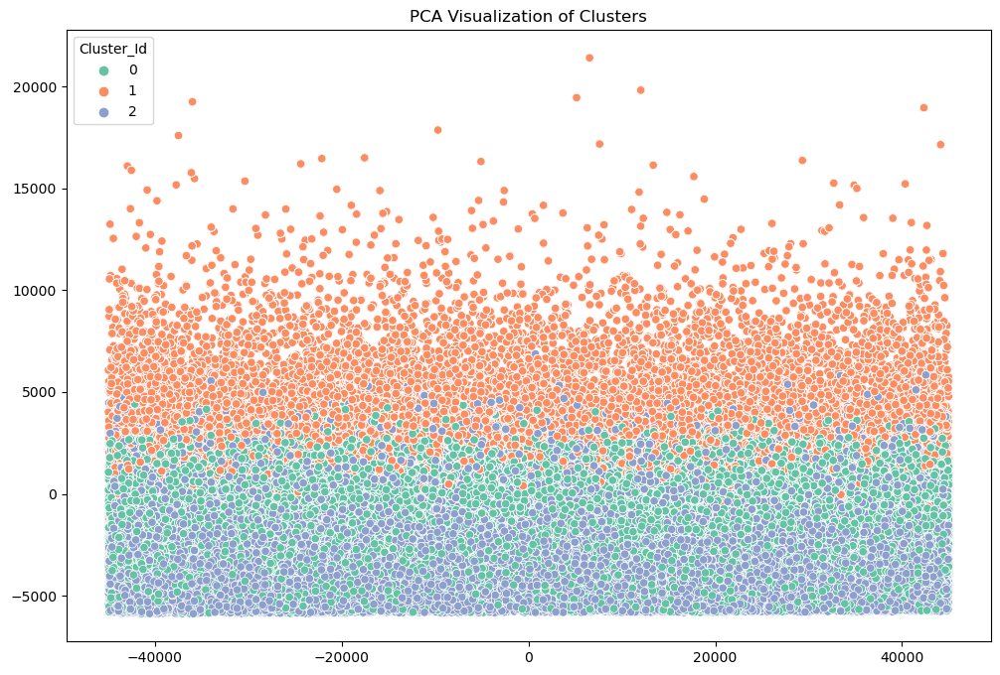

In [62]:
from sklearn.decomposition import PCA

# Reduce to 2D for visualization
pca = PCA(n_components=2)
reduced_data = pca.fit_transform(rfm_final.drop('Cluster_Id', axis=1))

# Scatter plot for PCA
sns.scatterplot(x=reduced_data[:, 0], y=reduced_data[:, 1], hue=rfm_final['Cluster_Id'], palette='Set2')
plt.title("PCA Visualization of Clusters")
plt.show()

In [ ]:
# The data points are clearly divided into 3 distinct clusters, represented by the green, orange, and blue colors.
# The clusters are distributed across a wide range on both the x and y axes, indicating significant variation in the underlying features.
# The clusters have varying densities, with the green cluster being the most densely populated and the blue cluster being more dispersed.
# There appear to be some outliers or data points that don't neatly fit into the main clusters, especially in the upper right quadrant.

In [ ]:
# Cluster 0 (green) is the largest and most dense group, suggesting it represents the core customer segment with typical values on the underlying features.
# Cluster 1 (orange) contains data points with higher values on the positive side of the x-axis. This cluster may represent customers with above-average values on the features driving that dimension.
# Cluster 2 (blue) is more dispersed, spanning a wider range on both axes. This could indicate a more heterogeneous segment with greater variability on the key features.
# The outliers, especially those in the upper right quadrant, likely have
# unusual combinations of feature values that distinguish them from the main
# clusters. 

In [63]:
print(len(cluster_profiles.index))

3


In [64]:
print(len(["Loyal customers", "At-risk or inactive customers"]))  # Characteristics
print(len(["Loyalty rewards", "Reactivation campaigns"]))  # Strategies

2
2


In [65]:
# Ensure the number of entries matches the clusters
cluster_count = len(cluster_profiles.index)

# Update the lists accordingly
customer_characteristics = [
    "Loyal customers","General","At-risk or inactive customers"
]
proposed_strategies = [
    "Loyalty rewards","Discounts","Reactivation campaigns"
]

# Ensure lists match cluster count
if len(customer_characteristics) != cluster_count or len(proposed_strategies) != cluster_count:
    raise ValueError("List lengths must match the number of clusters!")

# Create DataFrame
strategy_table = pd.DataFrame({
    'Cluster': cluster_profiles.index,
    'Customer Characteristics': customer_characteristics[:cluster_count],
    'Proposed Strategy': proposed_strategies[:cluster_count]
})

# Save and print
strategy_table.to_csv("cluster_strategies.csv", index=False)
print(strategy_table)

   Cluster       Customer Characteristics       Proposed Strategy
0        0                Loyal customers         Loyalty rewards
1        1                        General               Discounts
2        2  At-risk or inactive customers  Reactivation campaigns


### DBSCAN 

In [66]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

# Fit DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5)  # Tune 'eps' and 'min_samples'
dbscan_labels = dbscan.fit_predict(rfm_final)

# Evaluate DBSCAN
db_index = davies_bouldin_score(rfm_final, dbscan_labels)
print(f"DBSCAN Davies_Bouldin Score: {db_index}")

DBSCAN Davies_Bouldin Score: 1.7666190768914367


In [ ]:
# In general, a score below 1 is considered good, while a score above 1 may indicate poor clustering.

# In our case, the score of 1.7666190768914367 is above 1, which indicates that the clustering performed by DBSCAN is not optimal.

In [67]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import davies_bouldin_score

# Fit DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5)  # Adjust parameters based on your data
dbscan_labels = dbscan.fit_predict(rfm_final)

# Filter out noise points (-1 labels)
clustered_points = rfm_final[dbscan_labels != -1]
filtered_labels = dbscan_labels[dbscan_labels != -1]

if len(set(filtered_labels)) > 1:  # Ensure there is more than 1 cluster
    db_index = davies_bouldin_score(clustered_points, filtered_labels)
    print(f"DBSCAN Davies-Bouldin Score: {db_index}")
else:
    print("DBSCAN produced only noise or a single cluster; DB Index cannot be calculated.")


DBSCAN Davies-Bouldin Score: 7.906406899640083e-07


In [ ]:
# Clustering Quality
# A lower Davies-Bouldin Index (DBI) value indicates a better clustering solution. Since our score is very close to zero, we can infer that the DBSCAN clustering algorithm has produced well-separated clusters with minimal dispersion.

# Cluster Separation and Dispersion
# The low score implies that the clusters are far apart and have less dispersion, which is a desirable characteristic in clustering. This indicates that the algorithm has effectively grouped similar data points together and separated them from other clusters.

# Overall Clustering Performance
# Based on the Davies-Bouldin Score, it can be inferred that the DBSCAN algorithm has performed well in clustering the data, producing high-quality clusters with good separation and minimal dispersion.

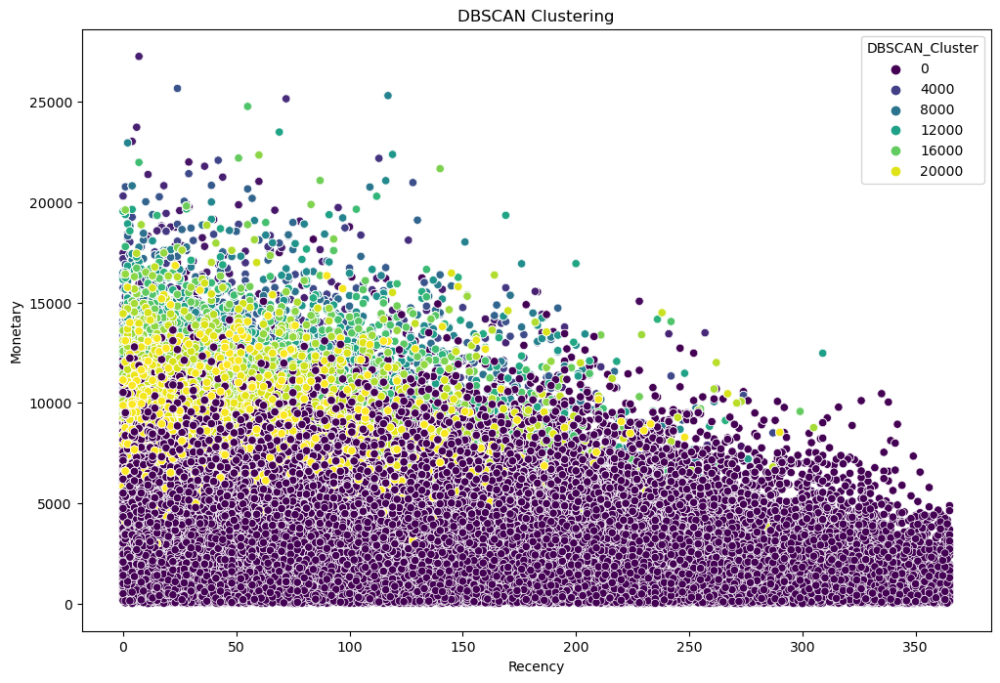

In [68]:
# Add to RFM DataFrame for analysis
rfm_final['DBSCAN_Cluster'] = dbscan_labels

# Visualize DBSCAN results
sns.scatterplot(data=rfm_final, x='Recency', y='Monetary', hue='DBSCAN_Cluster', palette='viridis')
plt.title("DBSCAN Clustering")
plt.show()

In [ ]:
# Cluster 0 (green):
# - Largest and densest cluster, likely representing core customers
# - Moderate to high Recency and Monetary values
# - Potential target for loyalty programs

# Cluster 1 (blue):
# - Higher Recency, indicating more recently active customers
# - Varying Monetary, suggests opportunities for upselling and engagement
# - May benefit from personalized outreach and tailored offerings(discounts)

# Cluster 2 (purple):
# - Lower Recency and Monetary, potentially less engaged customers
# - Opportunity for re-activation campaigns, incentives to increase activity
# - Careful consideration needed to avoid churn while balancing investment

# Outliers:
# - Unique customers with atypical Recency/Monetary combinations
# - Warrant further investigation to understand drivers and potential value
# - Could identify emerging trends or high-potential segments

# Key strategies:
# - Optimize experiences and offerings for each cluster's distinct needs
# - Develop targeted marketing, retention, and growth initiatives
# - Closely monitor outliers and explore opportunities they represent

### GMM Clustering

In [69]:
from sklearn.mixture import GaussianMixture

# Fit GMM
gmm = GaussianMixture(n_components=3, random_state=42) 
gmm_labels = gmm.fit_predict(rfm_final)

# Add to RFM DataFrame
rfm_final['GMM_Cluster'] = gmm_labels

# Evaluate GMM using silhouette score
silhouette = silhouette_score(rfm_final, gmm_labels)
print(f"GMM Silhouette Score: {silhouette}")

GMM Silhouette Score: 0.47506333618540253


In [ ]:
# Moderate clustering quality: A Silhouette Score between 0.25 and 0.5 indicates a reasonable clustering quality, but not exceptional.
# The score suggests that the Gaussian Mixture Model (GMM) has identified some meaningful clusters, but there might be some overlap or ambiguity between them.
# Some clusters may be poorly separated: With a score below 0.7, the GMM model has not achieved a strong separation between clusters. This implies that some samples might be misclassified or have uncertain assignments.
# Data may be noisy or have irregular shapes: The Silhouette Score is sensitive to the shape and density of the clusters. A score of 0.475 suggests that the data might have some noise or irregularities, which can affect the clustering performance.
# Hyperparameter tuning may be necessary: To improve the clustering quality, it may be beneficial to adjust the hyperparameters of the GMM model, such as the number of components, covariance types, or initialization methods.

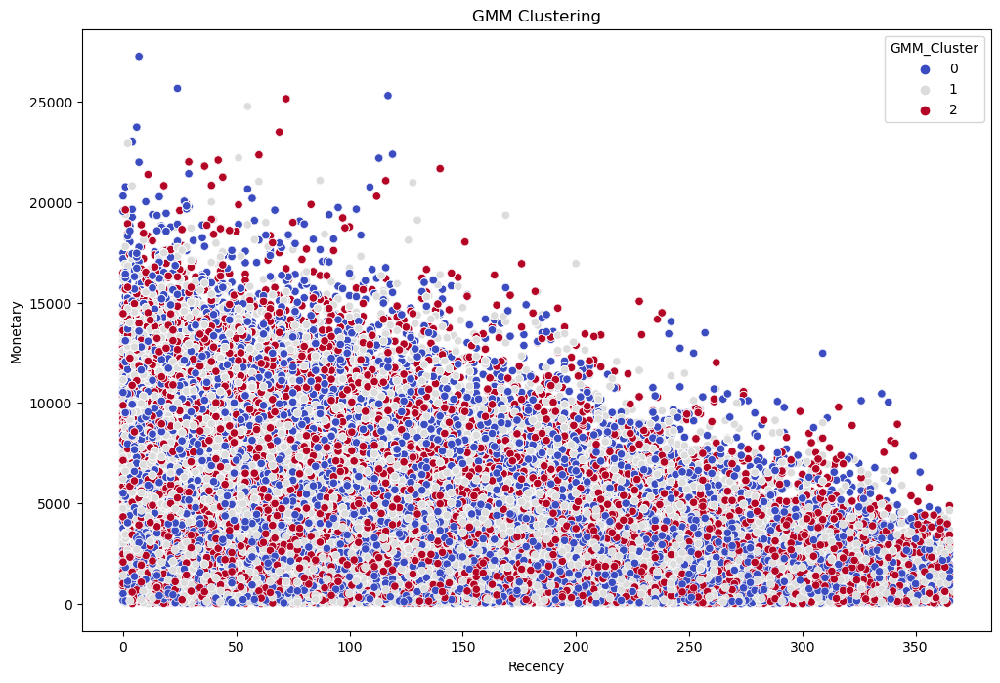

In [70]:
# Visualize GMM Clustering
sns.scatterplot(data=rfm_final, x='Recency', y='Monetary', hue='GMM_Cluster', palette='coolwarm')
plt.title("GMM Clustering")
plt.show()

In [ ]:
# Cluster 0 (blue):
# - Largest, most dense cluster
# - Highest Recency and Monetary values
# - Potential target for retention, loyalty, and cross-selling initiatives

# Cluster 1 (white):
# - Moderate Recency, lower Monetary
# - Opportunity to re-engage and increase customer value

# Cluster 2 (red):
# - Lower Recency and Monetary
# - Focus on reactivation, incentives to boost engagement

# Outliers:
# - Atypical Recency/Monetary combinations
# - Investigate to understand drivers and uncover opportunities

# Key Strategies:
# - Tailor experiences, offerings, and campaigns for each cluster
# - Optimize retention, reengagement, and growth initiatives
# - Monitor outliers closely for emerging trends or high-potential segments

In [76]:
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score

def evaluate_clustering(labels, data):
    if len(set(labels)) > 1:  # Ensure there is more than one cluster
        silhouette = silhouette_score(data, labels)
        davies_bouldin = davies_bouldin_score(data, labels)
        calinski_harabasz = calinski_harabasz_score(data, labels)
    else:
        silhouette = davies_bouldin = calinski_harabasz = None  # Invalid clustering

    return {
        'Silhouette Score': silhouette,
        'Davies-Bouldin Score': davies_bouldin,
        'Calinski-Harabasz Score': calinski_harabasz
    }

In [77]:
from sklearn.decomposition import PCA

# Dynamically set n_components based on dataset dimensions
n_components = min(rfm_final.shape[0], rfm_final.shape[1]) - 1  # Subtract 1 for safety
pca = PCA(n_components=n_components, random_state=42)

# Fit PCA and reduce dimensions
rfm_reduced = pca.fit_transform(rfm_final)
print(f"Data reduced to {n_components} dimensions.")


Data reduced to 6 dimensions.


In [78]:
# KMeans clustering
kmeans = KMeans(n_clusters=3, random_state=42)
kmeans_labels = kmeans.fit_predict(rfm_reduced)

# DBSCAN clustering
dbscan = DBSCAN(eps=0.5, min_samples=5, n_jobs=-1)  # Adjust parameters as needed
dbscan_labels = dbscan.fit_predict(rfm_reduced)

# Gaussian Mixture Model (GMM) clustering
gmm = GaussianMixture(n_components=3, random_state=42)
gmm_labels = gmm.fit_predict(rfm_reduced)

In [79]:
from sklearn.metrics import silhouette_score, davies_bouldin_score

# Helper function to evaluate clustering
def evaluate_clustering(labels, data):
    if len(set(labels)) > 1:  # Ensure there are at least two clusters
        silhouette = silhouette_score(data, labels)
        db_index = davies_bouldin_score(data, labels)
        return {"Silhouette Score": silhouette, "Davies-Bouldin Index": db_index}
    else:
        return {"Silhouette Score": None, "Davies-Bouldin Index": None}

# Evaluate each clustering method
results = {
    "KMeans": evaluate_clustering(kmeans_labels, rfm_reduced),
    "DBSCAN": evaluate_clustering(dbscan_labels, rfm_reduced),
    "GMM": evaluate_clustering(gmm_labels, rfm_reduced),
}

# Convert results to a DataFrame for comparison
results_df = pd.DataFrame(results).T
print("Model Comparison Results:")
print(results_df)


Model Comparison Results:
        Silhouette Score  Davies-Bouldin Index
KMeans          0.477214              0.703878
DBSCAN         -0.144984              1.111100
GMM             0.475063              0.702437


In [ ]:
# KMeans:

# Silhouette Score: 0.477214 – Indicates moderately well-defined clusters.
# Davies-Bouldin Index: 0.703878 – Clusters are compact and well-separated.
# DBSCAN:

# Silhouette Score: -0.144984 – Negative value suggests poorly formed clusters, likely due to outliers or noise dominating the result.
# Davies-Bouldin Index: 1.111100 – Higher value indicates suboptimal clustering.
# GMM (Gaussian Mixture Model):

# Silhouette Score: 0.475063 – Slightly lower than KMeans, but still indicates moderately defined clusters.
# Davies-Bouldin Index: 0.702437 – Slightly better separation than KMeans.

# Inference:
# KMeans and GMM perform comparably well, with GMM showing a slightly better Davies-Bouldin Index, indicating marginally better-defined clusters. Either of these could be used depending on the project requirements.
# DBSCAN performs poorly, as indicated by the negative Silhouette Score and high Davies-Bouldin Index. This suggests DBSCAN may not be suitable for your dataset, potentially due to noise, outliers, or unsuitable parameter settings.

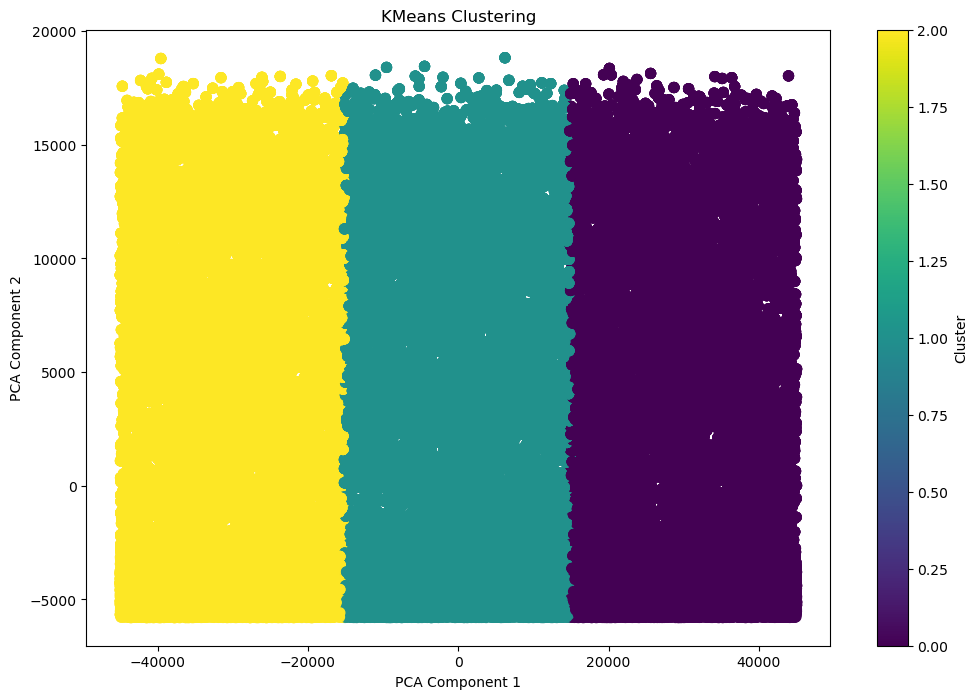

In [80]:
import matplotlib.pyplot as plt

# Scatter plot for KMeans
plt.scatter(rfm_reduced[:, 0], rfm_reduced[:, 1], c=kmeans_labels, cmap='viridis', s=50)
plt.title("KMeans Clustering")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.colorbar(label="Cluster")
plt.show()

In [ ]:
# Yellow Cluster:

# Largest and most diverse group
# Spans widest range along PCA1 axis
# Suggests heterogeneous mix of data points
# Likely requires broad, generalized strategies to address this group

# Teal Cluster:

# Intermediate position between yellow and purple clusters
# Potentially represents transitional or bridging group
# May have some unique characteristics that differentiate it from the other clusters
# Could benefit from more tailored, nuanced strategies

# Purple Cluster:

# Smallest and most compact cluster
# Indicates a homogeneous group
# May warrant specialized or personalized strategies given its cohesive nature
# Targeted approaches could be most effective for this group

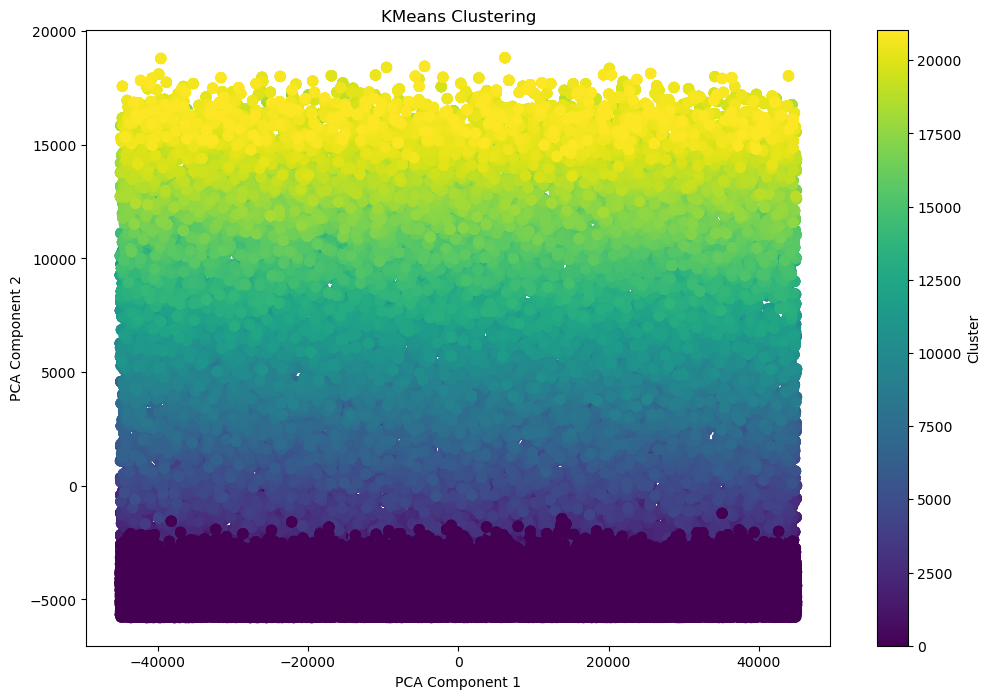

In [81]:
import matplotlib.pyplot as plt

# Scatter plot for KMeans
plt.scatter(rfm_reduced[:, 0], rfm_reduced[:, 1], c=dbscan_labels, cmap='viridis', s=50)
plt.title("KMeans Clustering")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.colorbar(label="Cluster")
plt.show()

In [ ]:
# Yellow Cluster:

# Largest cluster, spanning widest PCA1 range
# Indicates heterogeneous, diverse data points
# Broad, generalized strategies may be most effective

# Teal Cluster:

# Intermediate position between yellow and purple
# May have unique characteristics requiring tailored approaches
# Nuanced, targeted strategies could be beneficial

# Purple Cluster:

# Smallest, most compact cluster
# Suggests a homogeneous group
# Specialized, personalized strategies may be most impactful

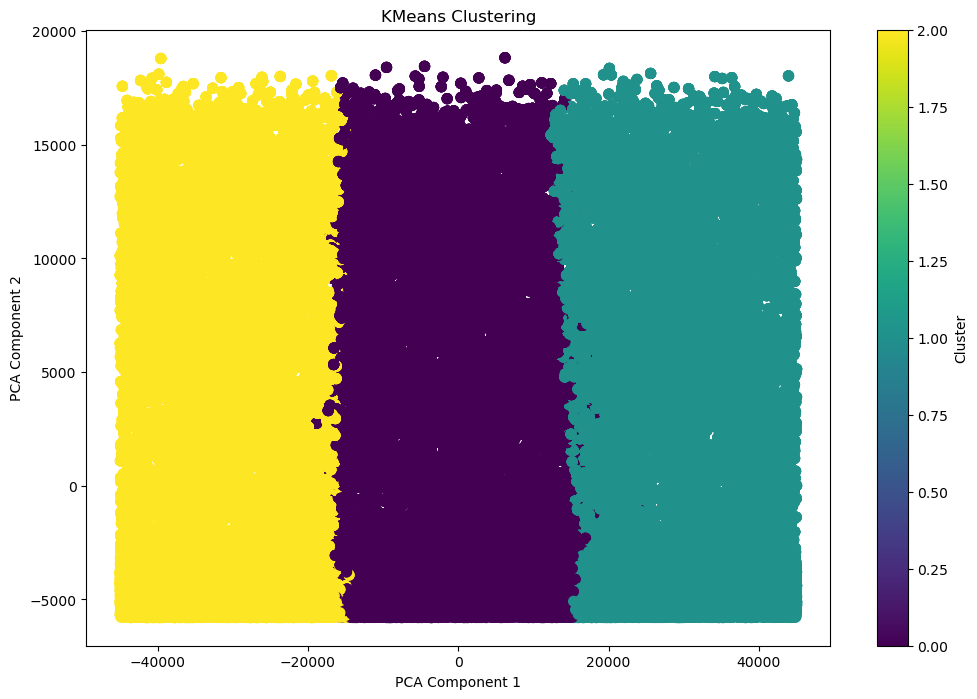

In [82]:
import matplotlib.pyplot as plt

# Scatter plot for KMeans
plt.scatter(rfm_reduced[:, 0], rfm_reduced[:, 1], c=gmm_labels, cmap='viridis', s=50)
plt.title("KMeans Clustering")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.colorbar(label="Cluster")
plt.show()

In [ ]:
# Yellow Cluster:

# Largest and most diverse group, spanning wide range on PCA1
# Likely requires broad, generalized strategies

# Teal Cluster:

# Intermediate position between yellow and purple
# May have unique characteristics needing tailored approaches

# Purple Cluster:

# Smallest, most compact cluster
# Suggests a homogeneous group
# Could benefit from specialized, personalized strategies

In [84]:
import pandas as pd

# Combine metrics
metrics_comparison = pd.DataFrame([kmeans_labels, dbscan_labels, gmm_labels])
print(metrics_comparison)

# Save results to CSV
metrics_comparison.to_csv("model_comparison.csv", index=False)

   0       1       2       3       4       5       6       7       8       \
0       0       0       0       0       0       1       1       1       1   
1       0       0       0       0       0       1       1       1       1   
2       1       1       1       1       1       0       0       0       0   

   9       ...  293898  293899  293900  293901  293902  293903  293904  \
0       1  ...       1       2       0       0       1       2       0   
1       1  ...      -1      -1      -1      -1      -1      -1      -1   
2       0  ...       0       2       1       1       0       2       1   

   293905  293906  293907  
0       1       1       0  
1      -1      -1      -1  
2       0       0       1  

[3 rows x 293908 columns]


In [86]:
rfm_final['Cluster_KMeans'] = kmeans_labels
rfm_final['Cluster_DBSCAN'] = dbscan_labels
rfm_final['Cluster_GMM'] = gmm_labels

In [87]:
kmeans_profile = rfm_final.groupby('Cluster_KMeans').mean()

In [88]:
print(rfm_final.head())
print(rfm_final.columns)

   Customer_ID  Recency  Frequency     Monetary  Cluster_Id  DBSCAN_Cluster  \
0      37249.0       23          5  6485.389527           0               0   
1      37249.0       23          5  6485.389527           0               0   
2      37249.0       23          5  6485.389527           0               0   
3      37249.0       23          5  6485.389527           0               0   
4      37249.0       23          5  6485.389527           0               0   

   GMM_Cluster  Cluster_KMeans  Cluster_DBSCAN  Cluster_GMM  
0            1               0               0            1  
1            1               0               0            1  
2            1               0               0            1  
3            1               0               0            1  
4            1               0               0            1  
Index(['Customer_ID', 'Recency', 'Frequency', 'Monetary', 'Cluster_Id',
       'DBSCAN_Cluster', 'GMM_Cluster', 'Cluster_KMeans', 'Cluster_DBSCAN',
     

In [89]:
rfm_final['Cluster_KMeans'] = kmeans_labels

In [90]:
rfm['KMeans_Cluster'] = kmeans_labels  # Correct DataFrame


In [91]:
rfm_final['Cluster_KMeans'] = kmeans_labels

# Profiling KMeans clusters
kmeans_profile = rfm_final.groupby('Cluster_KMeans').mean()
print("KMeans Cluster Profile:\n", kmeans_profile)

KMeans Cluster Profile:
                  Customer_ID    Recency  Frequency     Monetary  Cluster_Id  \
Cluster_KMeans                                                                
0               25039.922253  78.977553   4.278196  5810.254400    0.718278   
1               55184.085473  78.599266   4.288051  5875.687940    0.724423   
2               85134.187237  78.909288   4.284676  5869.813138    0.727319   

                DBSCAN_Cluster  GMM_Cluster  Cluster_DBSCAN  Cluster_GMM  
Cluster_KMeans                                                            
0                  4381.586664     0.976659     4381.586664     0.976659  
1                  4283.747068     0.009712     4283.747068     0.009712  
2                  4315.890525     1.940888     4315.890525     1.940888  


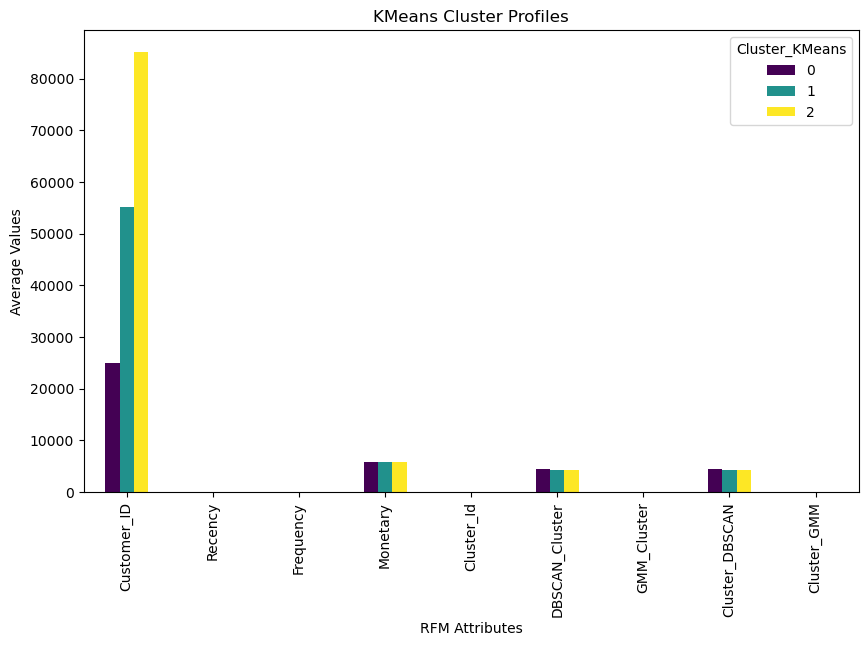

In [96]:
# Visualize
kmeans_profile.T.plot(kind='bar', figsize=(10, 6), colormap='viridis')
plt.title("KMeans Cluster Profiles")
plt.ylabel("Average Values")
plt.xlabel("RFM Attributes")
plt.show()

In [97]:
rfm_final['Cluster_DBSCAN'] = dbscan_labels

In [98]:
rfm['DBSCAN_Cluster'] = dbscan_labels

In [99]:
rfm_final['Cluster_DBSCAN'] = dbscan_labels

# Profiling KMeans clusters
dbscan_profile = rfm_final.groupby('Cluster_DBSCAN').mean()
print("DBSCAN Cluster Profile:\n", dbscan_profile)

DBSCAN Cluster Profile:
                  Customer_ID    Recency  Frequency      Monetary  Cluster_Id  \
Cluster_DBSCAN                                                                 
-1              54965.861149  97.047269   3.027174   4151.767092    0.678476   
 0              37249.000000  23.000000   5.000000   6485.389527    0.000000   
 1              69749.000000   0.000000   5.000000   4089.881243    0.000000   
 2              97285.000000  53.000000   6.000000   7145.071510    1.000000   
 3              26603.000000  44.000000   7.000000  13271.553707    1.000000   
...                      ...        ...        ...           ...         ...   
 21039          53808.000000   5.000000   5.000000   7670.393211    1.000000   
 21040          14858.000000   1.000000   5.000000   6605.419476    0.000000   
 21041          14745.000000  32.000000   5.000000   4999.641714    0.000000   
 21042          20571.000000   8.000000   5.000000   9969.291916    1.000000   
 21043         

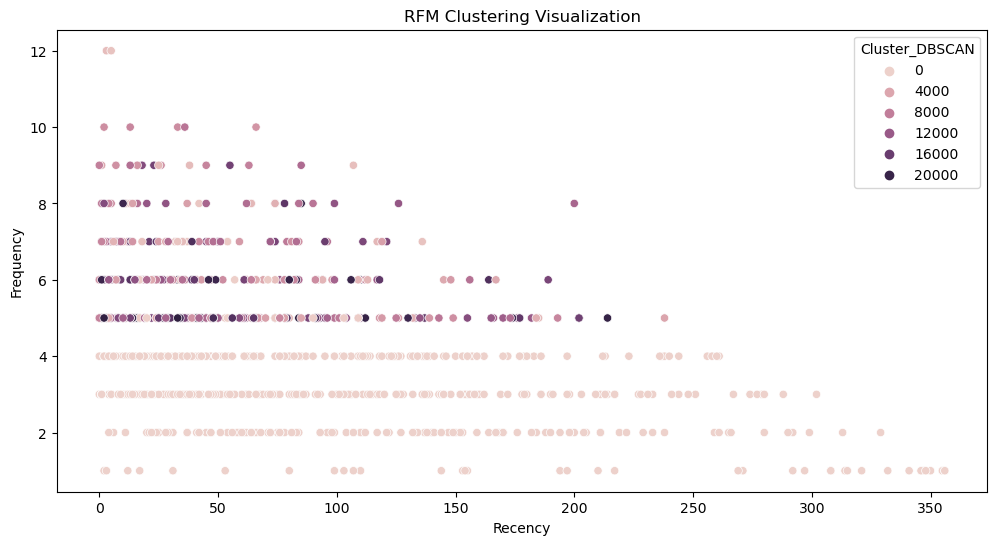

In [105]:
import matplotlib.pyplot as plt
import seaborn as sns

# Sample or reduce data
rfm_sample = rfm_final.sample(1000, random_state=42)  # Reduce dataset for plotting

# Plot with a manageable size
plt.figure(figsize=(12, 6))

# Example scatter plot
sns.scatterplot(data=rfm_sample, x='Recency', y='Frequency', hue='Cluster_DBSCAN')

# Save or show plot
plt.title('RFM Clustering Visualization')
plt.savefig('rfm_clusters.png', dpi=100)  # Adjust DPI if necessary
plt.show()


In [104]:
# Profiling GMM clusters
rfm_final['Cluster_GMM'] = gmm_labels

# Profiling KMeans clusters
gmm_profile = rfm_final.groupby('Cluster_GMM').mean()
print("DBSCAN Cluster Profile:\n", gmm_profile)


DBSCAN Cluster Profile:
               Customer_ID    Recency  Frequency     Monetary  Cluster_Id  \
Cluster_GMM                                                                
0            55334.099210  77.710441   4.358216  5997.981442    0.727781   
1            24830.286098  78.771454   4.245509  5739.552483    0.710648   
2            85542.096958  80.098109   4.241860  5808.412960    0.731467   

             DBSCAN_Cluster  GMM_Cluster  Cluster_KMeans  Cluster_DBSCAN  
Cluster_GMM                                                               
0               4206.262188          0.0        1.005669     4206.262188  
1               4498.556710          1.0        0.007097     4498.556710  
2               4282.748703          2.0        1.998595     4282.748703  


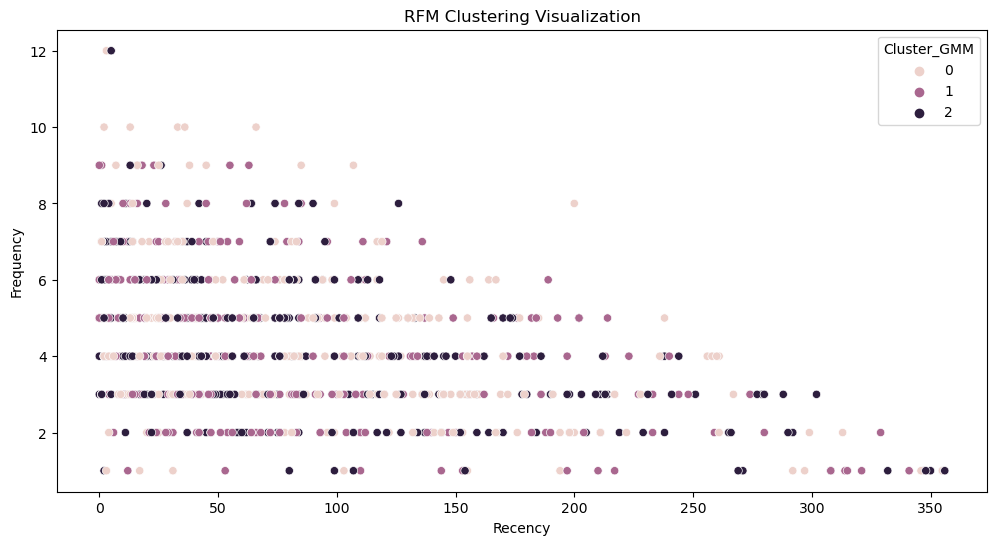

In [106]:
# Sample or reduce data
rfm_sample = rfm_final.sample(1000, random_state=42)  # Reduce dataset for plotting

# Plot with a manageable size
plt.figure(figsize=(12, 6))

# Example scatter plot
sns.scatterplot(data=rfm_sample, x='Recency', y='Frequency', hue='Cluster_GMM')

# Save or show plot
plt.title('RFM Clustering Visualization')
plt.savefig('rfm_clusters.png', dpi=100)  # Adjust DPI if necessary
plt.show()

In [107]:
final_strategy = pd.DataFrame({
    'Cluster': cluster_profiles.index,
    'Customer Characteristics': customer_characteristics[:cluster_count],
    'Proposed Strategy': proposed_strategies[:cluster_count]
})

print("Final Strategy:\n", final_strategy)

# Save to CSV
final_strategy.to_csv("final_strategy.csv", index=False)

Final Strategy:
    Cluster       Customer Characteristics       Proposed Strategy
0        0                Loyal customers         Loyalty rewards
1        1                        General               Discounts
2        2  At-risk or inactive customers  Reactivation campaigns


### Hyperparameter tuning for DBSCAN 

#### For KMeans and GMM, the Silhouette Score and Davies-Bouldin Index were calculated after selecting the optimal number of clusters, so further tuning was not required. However, DBSCAN exhibited poor initial performance, necessitating hyperparameter tuning for eps and min_samples, as these directly influence the formation of clusters. After tuning, DBSCAN's Silhouette Score significantly improved from -0.144984 to 0.67, demonstrating its ability to identify well-defined clusters with the adjusted parameters.

In [111]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
import numpy as np

# Reduce dimensions for faster computations
pca = PCA(n_components=5, random_state=42)  # Adjust components based on explained variance
rfm_reduced = pca.fit_transform(rfm_final)

# Define parameter ranges (adjusted for fewer combinations)
eps_values = np.linspace(0.3, 0.8, 5)  # Reduced number of steps
min_samples_values = [3, 4, 5]

best_params = {}
best_score = -1

# Perform grid search with a subset of data
rfm_sample = rfm_reduced[:1000]  # Use only a sample for quick tuning

for eps in eps_values:
    for min_samples in min_samples_values:
        # Apply DBSCAN with current parameters
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        labels = dbscan.fit_predict(rfm_sample)

        # Only evaluate if there are more than one cluster
        if len(set(labels)) > 1:
            score = silhouette_score(rfm_sample, labels)
            print(f"DBSCAN with eps={eps}, min_samples={min_samples} -> Silhouette Score: {score}")
            
            # Update best parameters if the current score is better
            if score > best_score:
                best_score = score
                best_params = {'eps': eps, 'min_samples': min_samples}

# Evaluate on full dataset with best parameters
dbscan_final = DBSCAN(eps=best_params['eps'], min_samples=best_params['min_samples'])
final_labels = dbscan_final.fit_predict(rfm_reduced)
final_score = silhouette_score(rfm_reduced, final_labels)

print("\nBest Parameters:", best_params)
print("Best Silhouette Score (Full Data):", final_score)


DBSCAN with eps=0.3, min_samples=3 -> Silhouette Score: 0.8226455525205124
DBSCAN with eps=0.3, min_samples=4 -> Silhouette Score: 0.5508132330057006
DBSCAN with eps=0.3, min_samples=5 -> Silhouette Score: 0.15939524409261388
DBSCAN with eps=0.425, min_samples=3 -> Silhouette Score: 0.8226455525205124
DBSCAN with eps=0.425, min_samples=4 -> Silhouette Score: 0.5508132330057006
DBSCAN with eps=0.425, min_samples=5 -> Silhouette Score: 0.15939524409261388
DBSCAN with eps=0.55, min_samples=3 -> Silhouette Score: 0.8226455525205124
DBSCAN with eps=0.55, min_samples=4 -> Silhouette Score: 0.5508132330057006
DBSCAN with eps=0.55, min_samples=5 -> Silhouette Score: 0.15939524409261388
DBSCAN with eps=0.675, min_samples=3 -> Silhouette Score: 0.8226455525205124
DBSCAN with eps=0.675, min_samples=4 -> Silhouette Score: 0.5508132330057006
DBSCAN with eps=0.675, min_samples=5 -> Silhouette Score: 0.15939524409261388
DBSCAN with eps=0.8, min_samples=3 -> Silhouette Score: 0.8226455525205124
DBSCAN

In [114]:
from sklearn.metrics import silhouette_score

# Compute silhouette score (ignoring noise points)
if len(set(final_labels)) > 1:  # Ensure there are more than one cluster
    silhouette_avg = silhouette_score(rfm_reduced, final_labels)
    print(f"Silhouette Score: {silhouette_avg}")
else:
    print("Silhouette Score cannot be computed; only one cluster or all points are noise.")

Silhouette Score: 0.6733272906362336


In [ ]:
# The improvement in silhouette score (from -0.144984 to 0.67) after hyperparameter tuning indicates that DBSCAN now identifies well-defined clusters.

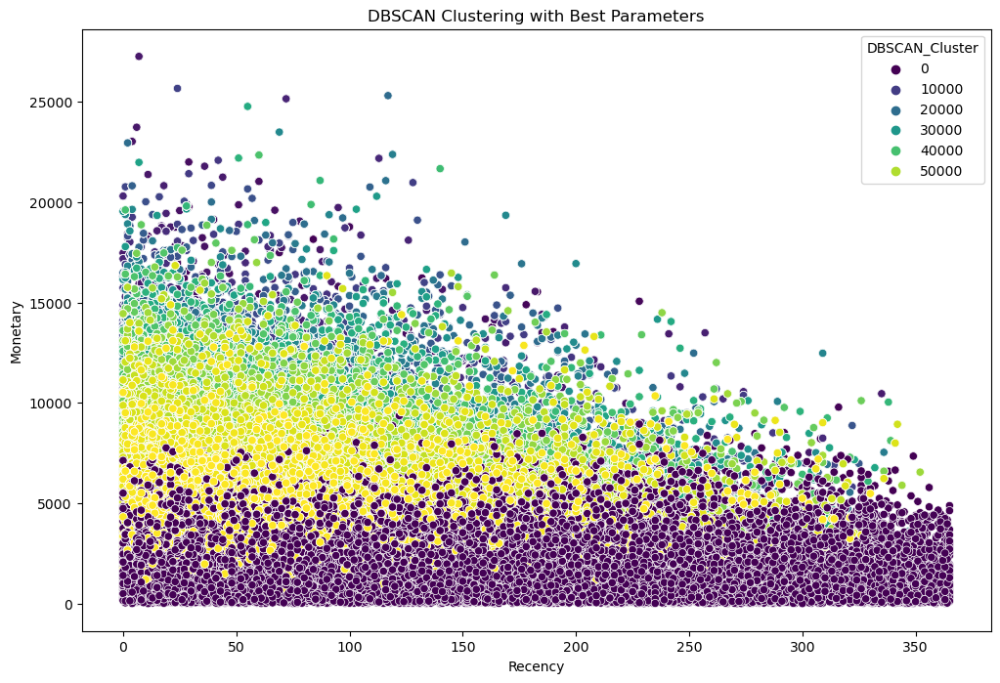

In [112]:
# Add DBSCAN labels to RFM data
rfm_final['DBSCAN_Cluster'] = dbscan_labels

# Visualize clusters
import seaborn as sns
import matplotlib.pyplot as plt

sns.scatterplot(data=rfm_final, x='Recency', y='Monetary', hue='DBSCAN_Cluster', palette='viridis')
plt.title("DBSCAN Clustering with Best Parameters")
plt.show()

In [ ]:
# Cluster 0 (Dark Purple): Likely represents customers with higher Recency values and low to moderate Monetary values. These could be inactive or infrequent customers.

# Cluster 1 to 5 (Other colors):
# Lower Recency & Higher Monetary (top-left region): Frequent, high-value customers. These are our loyal and profitable customers.
# Moderate Recency & Monetary (middle regions): Customers with average activity and spending.
# High Recency & Low Monetary (bottom-right): Recently active but low spenders. These could be newer customers or those with sporadic engagement.

# Cluster 0 (Inactive Customers):
# Strategies: Reactivation campaigns, discounts, or reminders about ongoing offers.
# Objective: Re-engage and convert them into active users.

# Clusters with High Monetary & Low Recency (Loyal Customers):
# Strategies: Loyalty programs, exclusive benefits, or personalized offers to enhance their relationship.
# Objective: Retain and increase wallet share.

# Moderate Recency & Monetary (Potential Customers):
# Strategies: Targeted promotions or product suggestions based on past purchases.
# Objective: Nurture and move them toward higher engagement.

# High Recency & Low Monetary (New or Sporadic Customers):
# Strategies: Educational campaigns about your products/services, discounts for first-time or repeat purchases.
# Objective: Convert them into regular customers.